In [1]:
pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121


Looking in indexes: https://download.pytorch.org/whl/cu121
  Using cached https://download.pytorch.org/whl/cu121/torchvision-0.20.1%2Bcu121-cp312-cp312-win_amd64.whl (6.1 MB)
  Using cached https://download.pytorch.org/whl/cu121/torch-2.5.1%2Bcu121-cp312-cp312-win_amd64.whl (2449.3 MB)
  Using cached https://download.pytorch.org/whl/sympy-1.13.1-py3-none-any.whl (6.2 MB)

  Attempting uninstall: sympy

    Found existing installation: sympy 1.14.0

   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
    Uninstalling sympy-1.14.0:
   ---------------------------------------- 0/3 [sympy]
   ---------------------------------------- 0/3 [sympy]
   ---------

CUDA CHECK

In [2]:
import torch
torch.cuda.is_available(), torch.cuda.get_device_name(0)

(True, 'NVIDIA GeForce RTX 3050 6GB Laptop GPU')

In [6]:
import time

x = torch.randn(5000, 5000).cuda()
y = torch.randn(5000, 5000).cuda()
start = time.time()
z = torch.mm(x, y)
torch.cuda.synchronize()
print(f"Time: {time.time() - start:.2f}s")

Time: 0.18s


In [9]:
import torch
import time

print("Starting sustained GPU workload...")
start = time.time()

# Larger, sustained computation
for i in range(50):  # 50 iterations
    x = torch.randn(4000, 4000).cuda()
    y = torch.randn(4000, 4000).cuda()
    z = torch.mm(x, y)
    
torch.cuda.synchronize()
total_time = time.time() - start
print(f"Total time for 50 large matrix multiplies: {total_time:.2f}s")
print(f"Average per multiply: {total_time/50:.3f}s")

# Check temperature if you have pynvml
try:
    from pynvml import *
    nvmlInit()
    handle = nvmlDeviceGetHandleByIndex(0)
    temp = nvmlDeviceGetTemperature(handle, NVML_TEMPERATURE_GPU)
    print(f"GPU Temperature: {temp}°C")
except:
    print("Install pynvml for temp monitoring: pip install pynvml")

Starting sustained GPU workload...
Total time for 50 large matrix multiplies: 10.40s
Average per multiply: 0.208s
GPU Temperature: 53°C


THE ACTUAL THING

1. LOADING AND PLOTTING

preprocessing starts by mapping the dataset and plotting the data. Because the data is in the form of .wav files, the samples which are already been separated by folders are stored in the form dictionary of pointers to their paths. To get clearer vision of the data which is being worked on, the data will be plotted into waveform, spectorgram, heatmap and pie chart which shows distribution between binary classes.

In [ ]:
import torchaudio 
import torchaudio.transforms as transform
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats as st
import shutil
import pandas as pd
import to_MLP_Utility as utl
import torch

In [10]:
import torchaudio
import torchaudio.transforms as transform
import numpy as np
import to_MLP_Utility as utl

import importlib

importlib.reload(utl)

<module 'to_MLP_Utility' from 'd:\\kuliah\\mbkm research\\ai voice detector\\preprocess\\to_MLP_Utility.py'>

grabbing datasets

In [22]:
cwd = os.getcwd()
print("Current working directory:", os.getcwd())

Current working directory: d:\kuliah\mbkm research\ai voice detector\preprocess


In [23]:
real_files_path_testing = os.path.join(cwd, "dataset", "for-norm", "testing", "real")
fake_files_path_testing = os.path.join(cwd, "dataset", "for-norm", "testing", "fake")
real_files_path_training = os.path.join(cwd, "dataset", "for-norm", "training", "real")
fake_files_path_training = os.path.join(cwd, "dataset", "for-norm", "training", "fake")
real_files_path_validation = os.path.join(cwd, "dataset", "for-norm", "validation", "real")
fake_files_path_validation = os.path.join(cwd, "dataset", "for-norm", "validation", "fake")

print("Exists?", os.path.exists(real_files_path_testing))
print("Exists?", os.path.exists(fake_files_path_testing))
print("Exists?", os.path.exists(real_files_path_training))
print("Exists?", os.path.exists(fake_files_path_training))
print("Exists?", os.path.exists(real_files_path_validation))
print("Exists?", os.path.exists(fake_files_path_validation))

file_paths = [real_files_path_testing, 
         fake_files_path_testing, 
         real_files_path_training, 
         fake_files_path_training, 
         real_files_path_validation, 
         fake_files_path_validation]

Exists? True
Exists? True
Exists? True
Exists? True
Exists? True
Exists? True


In [24]:
real_files_testing = os.listdir(real_files_path_testing)
fake_files_testing = os.listdir(fake_files_path_testing)
real_files_training = os.listdir(real_files_path_training)
fake_files_training = os.listdir(fake_files_path_training)
real_files_validation = os.listdir(real_files_path_validation)
fake_files_validation = os.listdir(fake_files_path_validation)


amount distribution

In [25]:
datasets = {
    "real_testing":   (real_files_path_testing, real_files_testing),
    "fake_testing":   (fake_files_path_testing, fake_files_testing),
    "real_training":  (real_files_path_training, real_files_training),
    "fake_training":  (fake_files_path_training, fake_files_training),
    "real_validation":(real_files_path_validation, real_files_validation),
    "fake_validation":(fake_files_path_validation, fake_files_validation)
}


#dictionary, item() --> gives the tuple of [key, value]
#so name and files are directly assinged to key and value sequantially

#in this dictionary, there are one key per items and two values
# key: (value1, value2)
for k, (v1, v2) in datasets.items():
    print(f"{k}: {v1}, {v2[5]}")

real_testing: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\testing\real, file1002.wav_16k.wav_norm.wav_mono.wav_silence.wav
fake_testing: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\testing\fake, file1002.wav_16k.wav_norm.wav_mono.wav_silence.wav
real_training: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\training\real, file10001.wav_16k.wav_norm.wav_mono.wav_silence.wav
fake_training: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\training\fake, file10005.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
real_validation: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\validation\real, file1005.wav_16k.wav_norm.wav_mono.wav_silence.wav
fake_validation: d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\validation\fake, file10024.wav_16k.wav_norm.wav_mono.wav_silence.wav


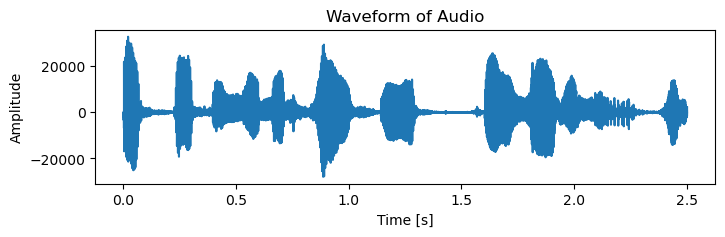

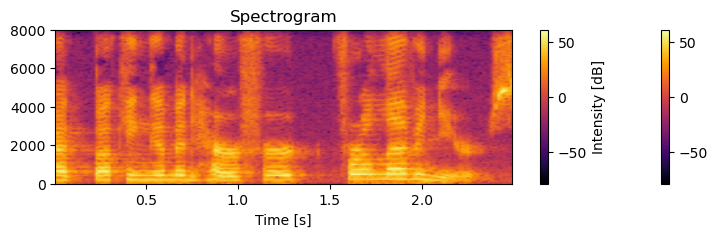

In [26]:
#spectogram
#real
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.signal import spectrogram

# Load a WAV file
sample_rate, data = wavfile.read("dataset/for-norm/training/real/file1.wav_16k.wav_norm.wav_mono.wav_silence.wav")

# If stereo, take only one channel
if len(data.shape) > 1:
    data = data[:, 0]

# Create time axis
import numpy as np
times = np.arange(len(data)) / sample_rate

# Plot waveform
plt.figure(figsize=(8, 2))
plt.plot(times, data)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title('Waveform of Audio')
plt.show()

# If stereo, take one channel
if len(data.shape) > 1:
    data = data[:, 0]

# Compute the spectrogram
frequencies, times, Sxx = spectrogram(data, fs=sample_rate)

# Plot
plt.figure(figsize=(9.2, 2))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud', cmap='inferno')
plt.colorbar()
plt.xlabel('Time [s]')
plt.title('Spectrogram')
plt.colorbar(label='Intensity [dB]')
plt.show()


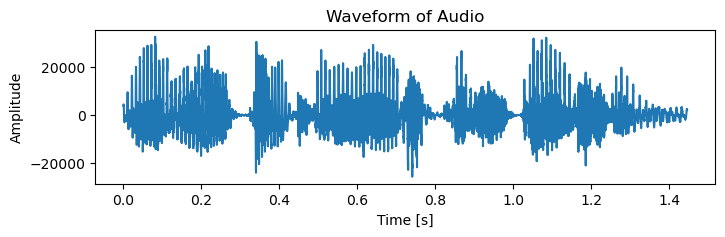

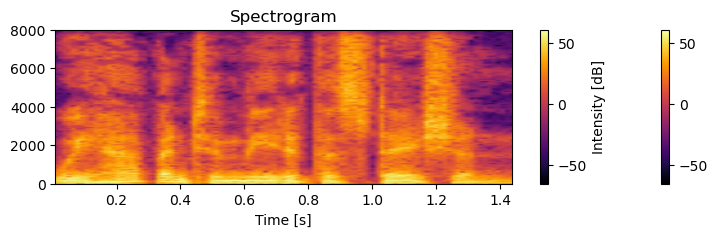

In [27]:
#spectogram
#real
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.signal import spectrogram

# Load a WAV file
sample_rate, data = wavfile.read("dataset/for-norm/training/fake/file3.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav")

# If stereo, take only one channel
if len(data.shape) > 1:
    data = data[:, 0]

# Create time axis
import numpy as np
times = np.arange(len(data)) / sample_rate

# Plot waveform
plt.figure(figsize=(8, 2))
plt.plot(times, data)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title('Waveform of Audio')
plt.show()


# If stereo, take one channel
if len(data.shape) > 1:
    data = data[:, 0]

# Compute the spectrogram
frequencies, times, Sxx = spectrogram(data, fs=sample_rate)

# Plot
plt.figure(figsize=(9.2, 2))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud', cmap='inferno')
plt.colorbar()
plt.xlabel('Time [s]')
plt.title('Spectrogram')
plt.colorbar(label='Intensity [dB]')
plt.show()


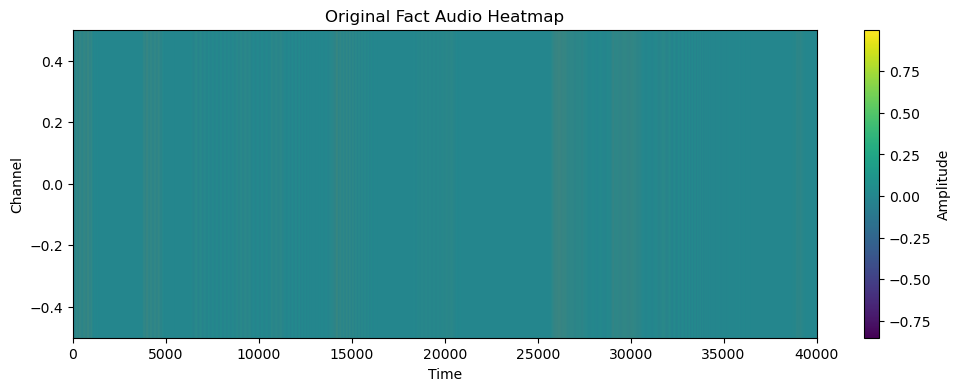

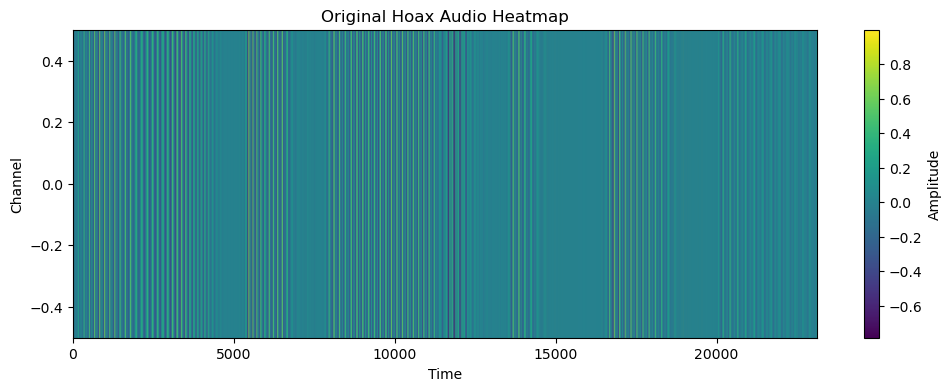

In [74]:
import torchaudio
import matplotlib.pyplot as plt

# Load the audio
waveform, sr = torchaudio.load("dataset/for-norm/training/real/file1.wav_16k.wav_norm.wav_mono.wav_silence.wav")  # replace with your file path

plt.figure(figsize=(12, 4))
plt.imshow(waveform.numpy(), aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Amplitude')
plt.title('Original Fact Audio Heatmap')
plt.xlabel('Time')
plt.ylabel('Channel')
plt.show()

# Load the audio
waveform, sr = torchaudio.load("dataset/for-norm/training/fake/file3.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav")  # replace with your file path

plt.figure(figsize=(12, 4))
plt.imshow(waveform.numpy(), aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Amplitude')
plt.title('Original Hoax Audio Heatmap')
plt.xlabel('Time')
plt.ylabel('Channel')
plt.show()


jumlah audio real_testing: 2264
Example:
  1. file1.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 39558]) 16000
  2. file10.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 43776]) 16000
  3. file100.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 15118]) 16000
  4. file1000.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 32117]) 16000
  5. file1001.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 33441]) 16000
----------------------------------------
jumlah audio fake_testing: 2370
Example:
  1. file1.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 25090]) 16000
  2. file10.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 19589]) 16000
  3. file100.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 44073]) 16000
  4. file1000.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 34574]) 16000
  5. file1001.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 35433]) 16000


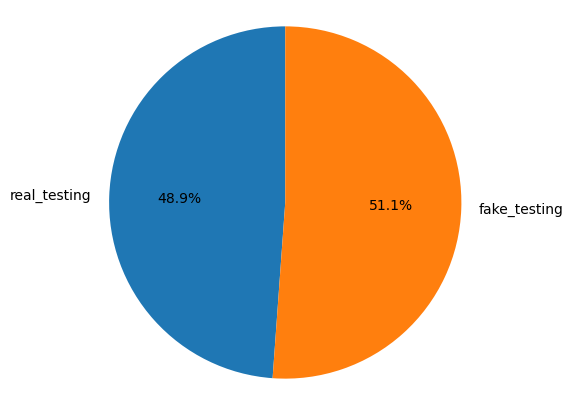

----------------------------------------
jumlah audio real_training: 26941
Example:
  1. file1.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 40026]) 16000
  2. file10.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 62458]) 16000
  3. file100.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 55857]) 16000
  4. file1000.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 152515]) 16000
  5. file10000.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 66962]) 16000
----------------------------------------
jumlah audio fake_training: 26927
Example:
  1. file1000.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 19752]) 16000
  2. file10000.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 30097]) 16000
  3. file10001.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 15021]) 16000
  4. file10002.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 16734]) 16000
  5. file10004.mp3.wav_16k.wav_norm.wav_mono.wav_sil

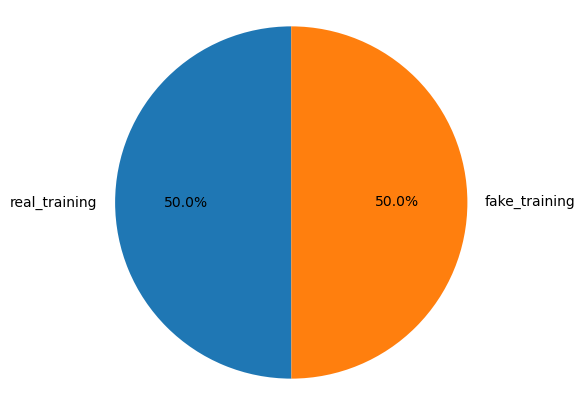

----------------------------------------
jumlah audio real_validation: 5400
Example:
  1. file10004.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 104049]) 16000
  2. file10014.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 58860]) 16000
  3. file10016.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 21812]) 16000
  4. file10022.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 52018]) 16000
  5. file10034.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 80082]) 16000
----------------------------------------
jumlah audio fake_validation: 5398
Example:
  1. file1.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 23411]) 16000
  2. file100.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 11196]) 16000
  3. file10003.mp3.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 15729]) 16000
  4. file10012.wav_16k.wav_norm.wav_mono.wav_silence.wav
torch.Size([1, 16074]) 16000
  5. file10017.wav_16k.wav_norm.wav_mono.wav_sile

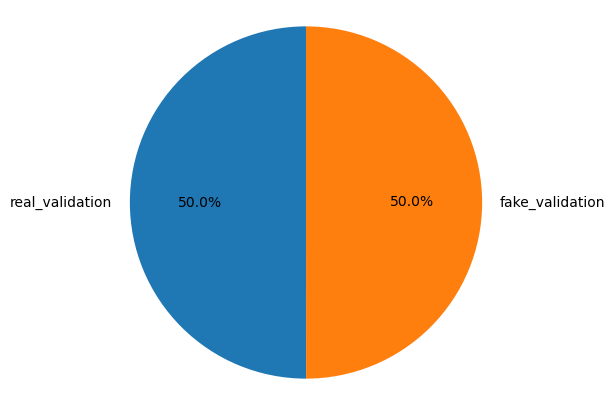

----------------------------------------


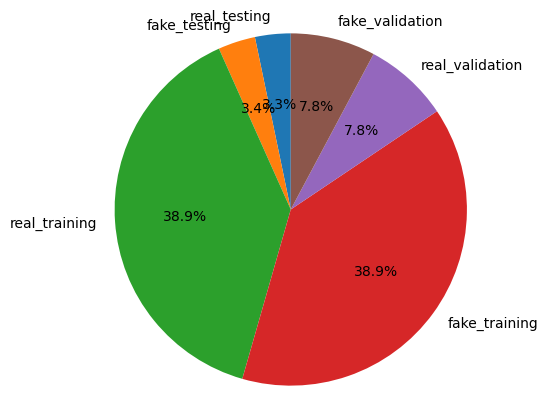

In [28]:
utl.plotter(datasets)


DURATION DISTRIBUTION

waveform, sample_rate = torchaudio.load(waveform_path) 
print(waveform.shape, sample_rate)

output:
torch.Size([1, 39558]) 16000

torch.Size([1, 39558]) --> waveform.

1. the first element is channel:
 - 1 means monoaudio, 2 means stereo (left and right channel)

2. the second one is number of samples (data points in the waveform).
 - Each sample is just one measurement of sound amplitude at a point in time.

16000 --> sample rate (kHz)
 - This means the audio was recorded (or resampled) at 16,000 samples per second (16 kHz).

 usually for AI voice detection, sample rate used is 16kHz and 1 channel

duration in seconds.
 - duration(s) = number of samples/sample rate

In [29]:
for i, (name, (file_paths, files)) in enumerate(datasets.items(), start=1):
    print("file_paths :", file_paths)
    print("name :", name)
    print("files :", files[: 5])

file_paths : d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\testing\real
name : real_testing
files : ['file1.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file10.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file100.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file1000.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file1001.wav_16k.wav_norm.wav_mono.wav_silence.wav']
file_paths : d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\testing\fake
name : fake_testing
files : ['file1.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file10.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file100.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file1000.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file1001.wav_16k.wav_norm.wav_mono.wav_silence.wav']
file_paths : d:\kuliah\mbkm research\ai voice detector\preprocess\dataset\for-norm\training\real
name : real_training
files : ['file1.wav_16k.wav_norm.wav_mono.wav_silence.wav', 'file10.wav_16k.wav_norm.wav_mono.wav_silenc

2. SEPARATOR

Each sample will be cut to the duration of 5 seconds exact. Any audio below low treshold (3 seconds) will be skipped. Any audio which duration below 3 seconds will be padded with 0 until it reach 5 seconds. Any audio which duration exceed the upper treshold (5 seconds) will be cut into chunks with it's tail follows the previous two rules. The audio_clean_separator() function takes earlier datasets dictionary and separate the path list to three .csv files: error_files.csv which contains error/unusable files in the dataset, [dataset_name]_below_treshold.csv which contains the files which are below high treshold, and outliers.csv which contain files which are above high treshold. This function also produce other statistical data for better dataset understanding such as highest duraion, mean value, mode value, and median value.

In [32]:

def audio_clean_separator(datasets):
    outlier_treshold = 6
    highest_duration = []


    #data = [("a", 10), ("b", 20)] --> rows of tuples
    for i, (name, (file_paths, files)) in enumerate(datasets.items(), start=1):
        error_files = [] #(dataset name, filename, paths, reason for error)
        outliers = [] # (filename, duration, path to file) -->doesnt need dataset name karena nanti dipisah perfolder
        bt_durations_data = [] #acceptable data with duration below threshold -->doesnt need dataset name karena nanti dipisah perfolder
        for f in files: 
            #shape of waveform tensor per samples.
            waveform_path = os.path.join(file_paths, f) #->full path to audio file
            try:
                info = torchaudio.info(waveform_path)
                duration = info.num_frames / info.sample_rate
                if duration >= outlier_treshold:
                    #outlier
                    outliers.append([f, duration, waveform_path])
                else:
                    bt_durations_data.append([f, duration, waveform_path])
            except Exception as e:
                print(f"Skipped {f} due to error: {e}")
                error_files.append([f, waveform_path, e])
                os.makedirs(os.path.join("datasets_separated/error_file_containers", name, f), exist_ok=True) #make path if doesnt exist
                shutil.copy2(waveform_path, os.path.join("datasets_separated/error_file_containers", name, f))
                # shutil.copy2(src, dst) --> copy2 preserve contents + metadata
                # this is the "true" copy paste like from UI

        #make each folder for each datasets
        os.makedirs(os.path.join(f"datasets_separated", name), exist_ok=True) #exist_oke = True means that if the directory already existe, the system wont return an error

        #making record for error files
        error_files = pd.DataFrame(error_files, columns=["file name", "file path", "reason for error"])
        error_files.to_csv(f"datasets_separated/{name}/error_files.csv", index=True)

        #making record for outliers
        outliers_datas = pd.DataFrame(outliers, columns=["file name", "duration", "file path"])
        outliers_datas.to_csv(f"datasets_separated/{name}/outliers.csv", index=True)

        #making record for below treshold files (valid datas but mostly need padding)
        bt_durations_data = pd.DataFrame(bt_durations_data, columns=["file name", "duration", "file path"])
        bt_durations_data.to_csv(f"datasets_separated/{name}/{name}_below_treshold.csv", index=True)

        #validasi jumlah
        print("number of error:", len(error_files))
        print("number of outliers", len(outliers))
        print("number of valid data (exc padding)", len(bt_durations_data))


        #convert durations to numpy
        bt_durations = np.array(bt_durations_data)

        #extract the durations only
        bt_durations = bt_durations[:, 1].astype(float) #-->(dtype=float64)
        #bt_durations_data is a list of tuples.
        #NumPy sees a slice like [:, 1] from an object array (the outer array of tuples).
        #Even though each element is a float, NumPy keeps the array as dtype=object because the parent array was an object array.
        #so we convert first to .astype(float)
        #sometimes there are functions who require "trully numeric" like np.round

        #find highest durations
        highest_duration.append(np.max(bt_durations))

        #mean, modus, median
        mean = np.mean(bt_durations) 
        rounded_durations = np.round(bt_durations, 2)  # round to 0.01s
        modus_value = st.mode(rounded_durations, keepdims=True).mode[0]# keepdims avoids scalar collapse
        median = np.median(bt_durations)  
        
        # Plot histogram for this dataset
        plt.figure(figsize=(6,4))
        plt.hist(bt_durations, bins=30, color="skyblue", edgecolor="black")
        plt.xlabel("Duration (seconds)")
        plt.ylabel("Number of clips")
        plt.title(f"Duration distribution - {name}")
        plt.show()
        print(f"highest duration for {name}: {highest_duration[i-1]}")
        print(f"mean value: {mean}")
        print(f"mode value (rounded): {modus_value}")
        print(f"median value: {median}") 
        print("-" * 40)  

    final_highest_duration = max(highest_duration)
    print(f"highest duration lists: {highest_duration}")
    print(f"final highest duration: {final_highest_duration}")
    


number of error: 0
number of outliers 0
number of valid data (exc padding) 2264


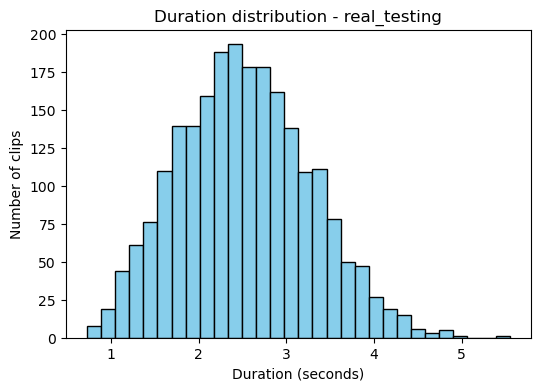

highest duration for real_testing: 5.548375
mean value: 2.519818297261484
mode value (rounded): 2.44
median value: 2.49109375
----------------------------------------
number of error: 0
number of outliers 0
number of valid data (exc padding) 2370


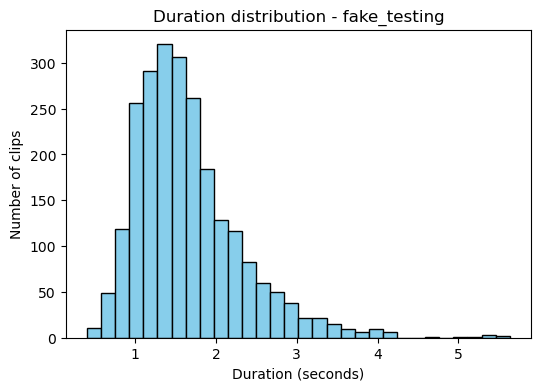

highest duration for fake_testing: 5.635125
mean value: 1.655329984177215
mode value (rounded): 1.66
median value: 1.52509375
----------------------------------------
Skipped file11064.wav_16k.wav_norm.wav_mono.wav_silence.wav due to error: Failed to decode audio.
Skipped file15440.wav_16k.wav_norm.wav_mono.wav_silence.wav due to error: Failed to decode audio.
number of error: 2
number of outliers 7559
number of valid data (exc padding) 19380


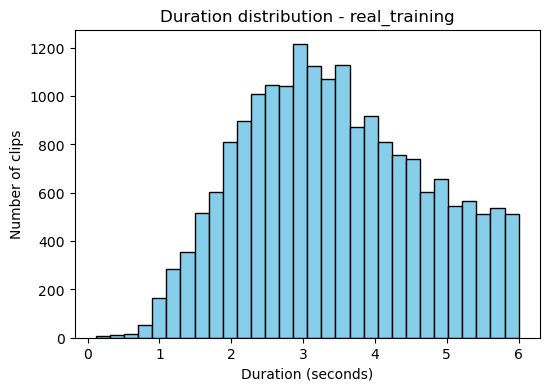

highest duration for real_training: 5.999875
mean value: 3.4490526541537667
mode value (rounded): 3.47
median value: 3.3456875
----------------------------------------
number of error: 0
number of outliers 14
number of valid data (exc padding) 26913


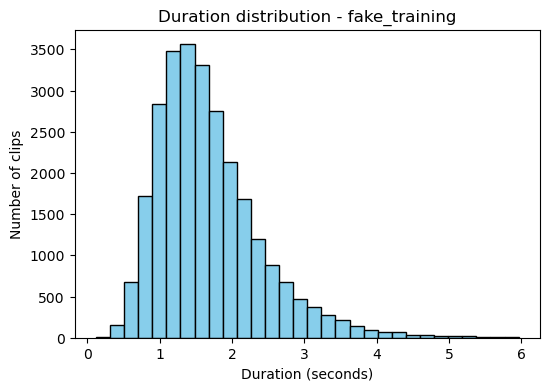

highest duration for fake_training: 5.96325
mean value: 1.674554462527403
mode value (rounded): 1.38
median value: 1.539625
----------------------------------------
number of error: 0
number of outliers 1501
number of valid data (exc padding) 3899


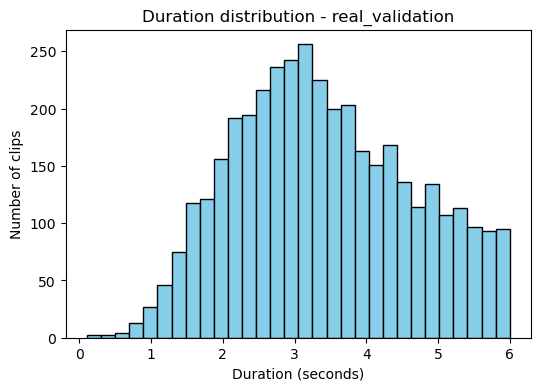

highest duration for real_validation: 5.9999375
mean value: 3.4146092427545525
mode value (rounded): 3.49
median value: 3.289125
----------------------------------------
number of error: 0
number of outliers 2
number of valid data (exc padding) 5396


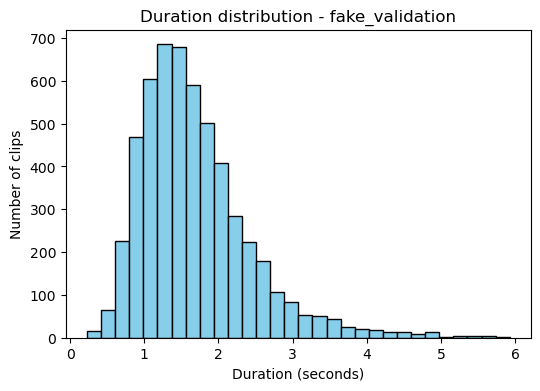

highest duration for fake_validation: 5.926875
mean value: 1.6842335757968865
mode value (rounded): 1.15
median value: 1.5464375
----------------------------------------
highest duration lists: [5.548375, 5.635125, 5.999875, 5.96325, 5.9999375, 5.926875]
final highest duration: 5.9999375


In [33]:

audio_clean_separator(datasets)

In [12]:
#load below treshold durations dataset
bt_durations = pd.concat([
    pd.read_csv("datasets_separated/fake_training/fake_training_below_treshold.csv"),
    pd.read_csv("datasets_separated/real_training/real_training_below_treshold.csv"),
    pd.read_csv("datasets_separated/fake_validation/fake_validation_below_treshold.csv"),
    pd.read_csv("datasets_separated/real_validation/real_validation_below_treshold.csv")
], ignore_index=True)


In [ ]:


#checking if all the elements is float
all_are_floats = all(isinstance(item, float) for item in bt_durations)
print(all_are_floats) # Output: True

#checking if all the elements is 16 kHz
all_are_floats = all(isinstance(item, float) for item in bt_durations)
print(all_are_floats) # Output: True

#note, is instance is only to check type

False
False


In [20]:
#outliers paths

outliers_path_real_training = os.path.join("datasets_separated", "real_training", "outliers.csv")  
outliers_path_fake_training = os.path.join("datasets_separated", "fake_training", "outliers.csv")  
outliers_path_real_validation = os.path.join("datasets_separated", "real_validation", "outliers.csv")  
outliers_path_fake_validation = os.path.join("datasets_separated", "fake_validation", "outliers.csv")  
outliers_path_real_testing = os.path.join("datasets_separated", "real_testing", "outliers.csv")
outliers_path_fake_testing = os.path.join("datasets_separated", "fake_testing", "outliers.csv")    

bt_path_real_training = os.path.join("datasets_separated", "real_training", "real_training_below_treshold.csv")
bt_path_fake_training = os.path.join("datasets_separated", "fake_training", "fake_training_below_treshold.csv")
bt_path_real_validation = os.path.join("datasets_separated", "real_validation", "real_validation_below_treshold.csv")
bt_path_fake_validation = os.path.join("datasets_separated", "fake_validation", "fake_validation_below_treshold.csv")
bt_path_real_testing = os.path.join("datasets_separated", "real_testing", "real_testing_below_treshold.csv")
bt_path_fake_testing = os.path.join("datasets_separated", "fake_testing", "fake_testing_below_treshold.csv")



print(outliers_path_real_training)
print(outliers_path_fake_training)
print(outliers_path_real_validation)
print(outliers_path_fake_validation)
print(outliers_path_real_testing)
print(outliers_path_fake_testing)

datasets_separated\real_training\outliers.csv
datasets_separated\fake_training\outliers.csv
datasets_separated\real_validation\outliers.csv
datasets_separated\fake_validation\outliers.csv
datasets_separated\real_testing\outliers.csv
datasets_separated\fake_testing\outliers.csv


cutting down outliers


planning:

-cut down training, val and test

-use training set cutted down to train the MLP head --> return and save the MLP's new weights

-then put the new weight on a new mlp classifier (this one doesnt need gradient descent or other loss reduction alg)

-use validation set to fine tune the MLP

-use test to test

In [21]:
import torchaudio
import torch
import math
import pandas as pd
import to_MLP_Utility as utl


import importlib
importlib.reload(utl)

<module 'to_MLP_Utility' from 'd:\\kuliah\\mbkm research\\ai voice detector\\preprocess\\to_MLP_Utility.py'>

In [22]:
#loading CSVs into pandas
#for real training outliers
df_training_real_outliers = pd.read_csv(outliers_path_real_training).drop('Unnamed: 0', axis=1)
df_training_real_outliers.head(5)



,file name,duration,file path
0,file1000.wav_16k.wav_norm.wav_mono.wav_silence...,9.532187,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10006.wav_16k.wav_norm.wav_mono.wav_silenc...,8.341125,d:\kuliah\mbkm research\ai voice detector\prep...
2,file10009.wav_16k.wav_norm.wav_mono.wav_silenc...,6.507500,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10013.wav_16k.wav_norm.wav_mono.wav_silenc...,8.442813,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10015.wav_16k.wav_norm.wav_mono.wav_silenc...,8.758375,d:\kuliah\mbkm research\ai voice detector\prep...


In [23]:
#for fake training outliers
df_training_fake_outliers = pd.read_csv(outliers_path_fake_training).drop('Unnamed: 0', axis=1)
df_training_fake_outliers.head(5)

,file name,duration,file path
0,file12045.mp3.wav_16k.wav_norm.wav_mono.wav_si...,6.239562,d:\kuliah\mbkm research\ai voice detector\prep...
1,file12857.mp3.wav_16k.wav_norm.wav_mono.wav_si...,6.244000,d:\kuliah\mbkm research\ai voice detector\prep...
2,file15037.mp3.wav_16k.wav_norm.wav_mono.wav_si...,6.101813,d:\kuliah\mbkm research\ai voice detector\prep...
3,file17792.mp3.wav_16k.wav_norm.wav_mono.wav_si...,6.453875,d:\kuliah\mbkm research\ai voice detector\prep...
4,file30118.mp3.wav_16k.wav_norm.wav_mono.wav_si...,7.138125,d:\kuliah\mbkm research\ai voice detector\prep...


In [24]:
#for fake validation outliers
df_validation_fake_outliers = pd.read_csv(outliers_path_fake_validation)
df_validation_fake_outliers.head(5)  

,Unnamed: 0,file name,duration,file path
0,0,file15346.mp3.wav_16k.wav_norm.wav_mono.wav_si...,8.406187,d:\kuliah\mbkm research\ai voice detector\prep...
1,1,file15454.mp3.wav_16k.wav_norm.wav_mono.wav_si...,7.225125,d:\kuliah\mbkm research\ai voice detector\prep...


In [25]:
#for real validation outliers
df_validation_real_outliers = pd.read_csv(outliers_path_real_validation).drop('Unnamed: 0', axis=1)
df_validation_real_outliers.head(5)  

,file name,duration,file path
0,file10004.wav_16k.wav_norm.wav_mono.wav_silenc...,6.503063,d:\kuliah\mbkm research\ai voice detector\prep...
1,file1005.wav_16k.wav_norm.wav_mono.wav_silence...,8.328812,d:\kuliah\mbkm research\ai voice detector\prep...
2,file10063.wav_16k.wav_norm.wav_mono.wav_silenc...,6.191187,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10082.wav_16k.wav_norm.wav_mono.wav_silenc...,8.747000,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10134.wav_16k.wav_norm.wav_mono.wav_silenc...,7.177625,d:\kuliah\mbkm research\ai voice detector\prep...


In [26]:
#for real testing outliers
df_test_real_outliers = pd.read_csv(outliers_path_real_testing).drop('Unnamed: 0', axis=1)
df_test_real_outliers.head(5)  

,file name,duration,file path


In [27]:
#for fake testing outliers
df_test_fake_outliers = pd.read_csv(outliers_path_fake_testing).drop('Unnamed: 0', axis=1)
df_test_fake_outliers.head(5)  

,file name,duration,file path


In [28]:
#for real training bt
df_training_real_bt = pd.read_csv(bt_path_real_training).drop('Unnamed: 0', axis=1)
df_training_real_bt.head(5) 

,file name,duration,file path
0,file1.wav_16k.wav_norm.wav_mono.wav_silence.wav,2.501625,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10.wav_16k.wav_norm.wav_mono.wav_silence.wav,3.903625,d:\kuliah\mbkm research\ai voice detector\prep...
2,file100.wav_16k.wav_norm.wav_mono.wav_silence.wav,3.491062,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10000.wav_16k.wav_norm.wav_mono.wav_silenc...,4.185125,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10001.wav_16k.wav_norm.wav_mono.wav_silenc...,2.079625,d:\kuliah\mbkm research\ai voice detector\prep...


In [29]:
#for fake training bt
df_training_fake_bt = pd.read_csv(bt_path_fake_training).drop('Unnamed: 0', axis=1)
df_training_fake_bt.head(5) 

,file name,duration,file path
0,file1000.mp3.wav_16k.wav_norm.wav_mono.wav_sil...,1.234500,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10000.mp3.wav_16k.wav_norm.wav_mono.wav_si...,1.881063,d:\kuliah\mbkm research\ai voice detector\prep...
2,file10001.mp3.wav_16k.wav_norm.wav_mono.wav_si...,0.938813,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10002.mp3.wav_16k.wav_norm.wav_mono.wav_si...,1.045875,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10004.mp3.wav_16k.wav_norm.wav_mono.wav_si...,0.977938,d:\kuliah\mbkm research\ai voice detector\prep...


In [30]:
#for real validation bt
df_validation_real_bt = pd.read_csv(bt_path_real_validation).drop('Unnamed: 0', axis=1)
df_validation_real_bt.head(5) 

,file name,duration,file path
0,file10014.wav_16k.wav_norm.wav_mono.wav_silenc...,3.678750,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10016.wav_16k.wav_norm.wav_mono.wav_silenc...,1.363250,d:\kuliah\mbkm research\ai voice detector\prep...
2,file10022.wav_16k.wav_norm.wav_mono.wav_silenc...,3.251125,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10034.wav_16k.wav_norm.wav_mono.wav_silenc...,5.005125,d:\kuliah\mbkm research\ai voice detector\prep...
4,file1006.wav_16k.wav_norm.wav_mono.wav_silence...,3.089562,d:\kuliah\mbkm research\ai voice detector\prep...


In [31]:
#for fake validation bt
df_validation_fake_bt = pd.read_csv(bt_path_fake_validation).drop('Unnamed: 0', axis=1)
df_validation_fake_bt.head(5) 

,file name,duration,file path
0,file1.mp3.wav_16k.wav_norm.wav_mono.wav_silenc...,1.463188,d:\kuliah\mbkm research\ai voice detector\prep...
1,file100.mp3.wav_16k.wav_norm.wav_mono.wav_sile...,0.699750,d:\kuliah\mbkm research\ai voice detector\prep...
2,file10003.mp3.wav_16k.wav_norm.wav_mono.wav_si...,0.983062,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10012.wav_16k.wav_norm.wav_mono.wav_silenc...,1.004625,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10017.wav_16k.wav_norm.wav_mono.wav_silenc...,1.608937,d:\kuliah\mbkm research\ai voice detector\prep...


In [32]:
#for real test bt
df_test_real_bt = pd.read_csv(bt_path_real_testing).drop('Unnamed: 0', axis=1)
df_test_real_bt.head(5) 

,file name,duration,file path
0,file1.wav_16k.wav_norm.wav_mono.wav_silence.wav,2.472375,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10.wav_16k.wav_norm.wav_mono.wav_silence.wav,2.736000,d:\kuliah\mbkm research\ai voice detector\prep...
2,file100.wav_16k.wav_norm.wav_mono.wav_silence.wav,0.944875,d:\kuliah\mbkm research\ai voice detector\prep...
3,file1000.wav_16k.wav_norm.wav_mono.wav_silence...,2.007312,d:\kuliah\mbkm research\ai voice detector\prep...
4,file1001.wav_16k.wav_norm.wav_mono.wav_silence...,2.090063,d:\kuliah\mbkm research\ai voice detector\prep...


In [33]:

#for fake test bt
df_test_fake_bt = pd.read_csv(bt_path_fake_testing).drop('Unnamed: 0', axis=1)
df_test_fake_bt.head(5) 

,file name,duration,file path
0,file1.wav_16k.wav_norm.wav_mono.wav_silence.wav,1.568125,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10.wav_16k.wav_norm.wav_mono.wav_silence.wav,1.224312,d:\kuliah\mbkm research\ai voice detector\prep...
2,file100.wav_16k.wav_norm.wav_mono.wav_silence.wav,2.754563,d:\kuliah\mbkm research\ai voice detector\prep...
3,file1000.wav_16k.wav_norm.wav_mono.wav_silence...,2.160875,d:\kuliah\mbkm research\ai voice detector\prep...
4,file1001.wav_16k.wav_norm.wav_mono.wav_silence...,2.214562,d:\kuliah\mbkm research\ai voice detector\prep...


In [34]:
'''
pandas access:

column:
df['column name']
df[['name', 'city']] --> multiple columns

rows: 
A. by index position (iloc) --> (integer location)
df.iloc[0] --> first row
df.iloc[0:2] --> first two rows (dari 0 sampe 2)
df.iloc[1, 2] --> row 1, column 2 

B. by label (loc)
df.loc[1] --> row with index 1
df.loc[[0, 2]]rows with indices (indices --> multiple index)
df.loc[1, 'city'] --> specific row+column

df.loc[:, "age"] --> all rows in column 'age'
df.loc[0:1, ["name", "city"]] --> row 0-1, column name and city

'''

'\npandas access:\n\ncolumn:\ndf[\'column name\']\ndf[[\'name\', \'city\']] --> multiple columns\n\nrows: \nA. by index position (iloc) --> (integer location)\ndf.iloc[0] --> first row\ndf.iloc[0:2] --> first two rows (dari 0 sampe 2)\ndf.iloc[1, 2] --> row 1, column 2 \n\nB. by label (loc)\ndf.loc[1] --> row with index 1\ndf.loc[[0, 2]]rows with indices (indices --> multiple index)\ndf.loc[1, \'city\'] --> specific row+column\n\ndf.loc[:, "age"] --> all rows in column \'age\'\ndf.loc[0:1, ["name", "city"]] --> row 0-1, column name and city\n\n'

Wav2Vec2 doesn’t work on “seconds,” it works on raw waveform samples (a 1D array of PCM values). An audio file is basically a sequence of samples:

samples = duration_seconds * sample_rate

So if we want to cap the audio to max_duration seconds, we convert that into max_samples.

note: we're saving the slices later as pointers instead of generating new files

3. Trimmer

From the .csv files procured by the second section, audio files are loaded into waveforms and are sliced and padded with a slicer function. The output is a list of tensors. In here too the lists are cleaned from missing data and flattened to ensure the shape of the lists. After all of the duration has been confirmed to be 5 seconds, the tensors are then labelled based on the raw file's folders, combined, and then saved as .pt file.

In [35]:

#treshold_high, treshold_low, data_set, data_set_name
#cutting down duration to treshold = 5
treshold_high = 5
treshold_low = 2

real_train_sliced = utl.audio_slicer(treshold_high, treshold_low, df_training_real_outliers, data_set_name = "df_training_real_outliers")
real_train_padded = utl.audio_slicer(treshold_high, treshold_low, df_training_real_bt, data_set_name="df_training_real_bt")


audio will be cut to this rate: 80000
this audio's duration: 9.5321875
samples: 152515
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 72515
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 8.341125
samples: 133458
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 53458
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 6.5075
samples: 104120
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 24120
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 8.4428125
samples: 135085
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 55085
chunk within treshold, padding.
----------------------------------------
audio will be cu

In [108]:
fake_train_padded

[[],
 [],
 [],
 [],
 [],
 [tensor([[0.1055, 0.1101, 0.0095,  ..., 0.0000, 0.0000, 0.0000]])],
 [],
 [tensor([[-0.0706, -0.0739, -0.0727,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [tensor([[-0.0782, -0.0652, -0.0838,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [tensor([[-0.1078, -0.1137, -0.1185,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [],
 [],
 [tensor([[-0.0303, -0.0259, -0.0100,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [tensor([[-0.0303, -0.0002,  0.0074,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [],
 [],
 [],
 [tensor([[0.2975, 0.3699, 0.3083,  ..., 0.0000, 0.0000, 0.0000]])],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [tensor([[0.0941, 0.0997, 0.1045,  ..., 0.0000, 0.0000, 0.0000]])],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [tensor([[ 0.1054,  0.0217, -0.0397,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [],
 [tensor([[-0.1945, -0.2478, -0.2606,  ...,  0.0000,  0.0000,  0.0000]])],
 [],
 [],
 [],
 [tensor([[0.1271, 0.1401, 0.1523,  ..., 0.0000, 0.0000, 0.0000]])],
 [],
 [],

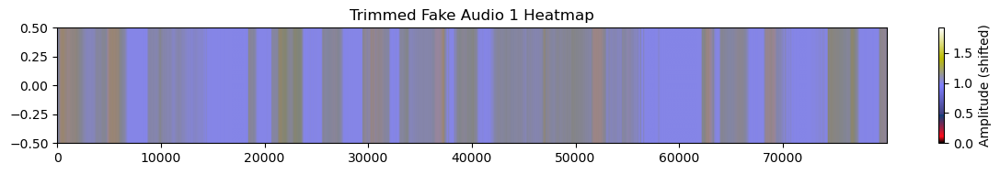

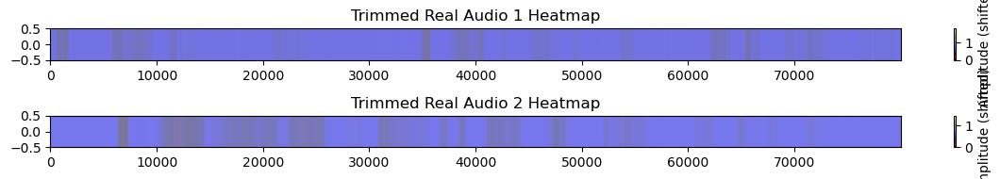

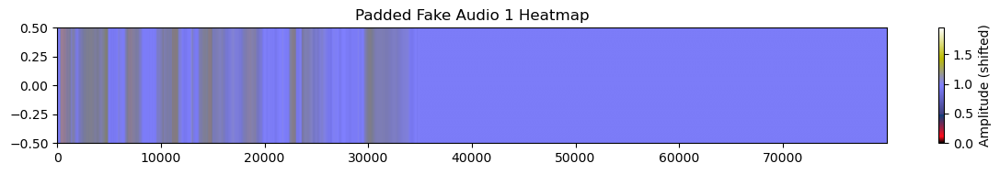

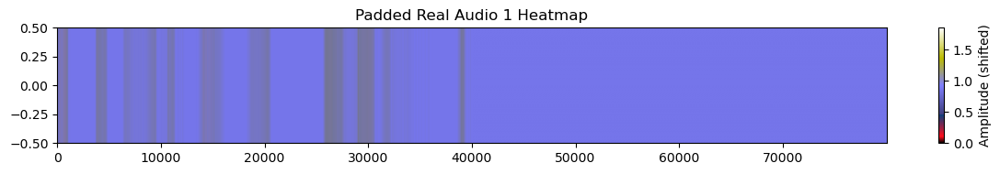

In [111]:
import torch
import matplotlib.pyplot as plt

shift_value = 0  # change if you want to shift the minimum

# ----------------- Trimmed Fake Audio -----------------
trimmed_audio = fake_train_sliced[0]

plt.figure(figsize=(12, 2))  # create figure
for i, t in enumerate(trimmed_audio):  # loop over tensors
    shifted = t.numpy() - t.min().item() + shift_value
    plt.subplot(len(trimmed_audio), 1, i+1)  # add subplot
    plt.imshow(shifted, aspect='auto', origin='lower', cmap='gist_stern', vmin=0)
    plt.colorbar(label='Amplitude (shifted)')
    plt.title(f'Trimmed Fake Audio {i+1} Heatmap')  # properly closed string

plt.tight_layout()
plt.show()


# ----------------- Trimmed Real Audio -----------------
trimmed_audio = real_train_sliced[0]
plt.figure(figsize=(12, 2))
for i, t in enumerate(trimmed_audio):
    shifted = t.numpy() - t.min().item() + shift_value
    plt.subplot(len(trimmed_audio), 1, i+1)
    plt.imshow(shifted, aspect='auto', origin='lower', cmap='gist_stern', vmin=0)
    plt.colorbar(label='Amplitude (shifted)')
    plt.title(f'Trimmed Real Audio {i+1} Heatmap')
plt.tight_layout()
plt.show()

# ----------------- Padded Fake Audio -----------------
padded_fake = fake_train_padded[5]  # make sure this is not empty
if len(padded_fake) == 0:
    print("No data in padded_fake!")
else:
    plt.figure(figsize=(12, 2 * len(padded_fake)))
    for i, t in enumerate(padded_fake):
        shifted = t.numpy() - t.min().item() + shift_value
        plt.subplot(len(padded_fake), 1, i+1)
        plt.imshow(shifted, aspect='auto', origin='lower', cmap='gist_stern', vmin=0)
        plt.colorbar(label='Amplitude (shifted)')
        plt.title(f'Padded Fake Audio {i+1} Heatmap')
    plt.tight_layout()
    plt.show()

# ----------------- Padded Real Audio -----------------
trimmed_audio = real_train_padded[0]
plt.figure(figsize=(12, 2))
for i, t in enumerate(trimmed_audio):
    shifted = t.numpy() - t.min().item() + shift_value
    plt.subplot(len(trimmed_audio), 1, i+1)
    plt.imshow(shifted, aspect='auto', origin='lower', cmap='gist_stern', vmin=0)
    plt.colorbar(label='Amplitude (shifted)')
    plt.title(f'Padded Real Audio {i+1} Heatmap')
plt.tight_layout()
plt.show()


In [89]:
fake_train_sliced = utl.audio_slicer(treshold_high, treshold_low, df_training_fake_outliers, data_set_name = "df_training_fake_outliers")
fake_train_padded = utl.audio_slicer(treshold_high, treshold_low, df_training_fake_bt, data_set_name = "df_training_fake_bt")


audio will be cut to this rate: 80000
this audio's duration: 6.2395625
samples: 99833
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 19833
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 6.244
samples: 99904
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 19904
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 6.1018125
samples: 97629
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 17629
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 6.453875
samples: 103262
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 23262
chunk below min treshold, skipping.
----------------------------------------
audio wi

In [29]:
treshold_high = 5
treshold_low = 2

real_val_sliced = utl.audio_slicer(treshold_high, treshold_low, df_validation_real_outliers, data_set_name = "df_val_real_outliers")
real_val_padded = utl.audio_slicer(treshold_high, treshold_low, df_validation_real_bt, data_set_name="df_val_real_bt")
fake_val_sliced = utl.audio_slicer(treshold_high, treshold_low, df_validation_fake_outliers, data_set_name = "df_val_fake_outliers")
fake_val_padded = utl.audio_slicer(treshold_high, treshold_low, df_validation_fake_bt, data_set_name = "df_val_fake_bt")


audio will be cut to this rate: 80000
this audio's duration: 6.5030625
samples: 104049
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 24049
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 8.3288125
samples: 133261
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 53261
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 6.1911875
samples: 99059
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 19059
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 8.747
samples: 139952
this chunk's size is 80000
chunk within treshold, padding.
this chunk's size is 59952
chunk within treshold, padding.
----------------------------------------
audio will be

In [30]:
real_test_padded = utl.audio_slicer(treshold_high, treshold_low, df_test_real_bt, data_set_name="df_test_real_bt")
fake_test_padded = utl.audio_slicer(treshold_high, treshold_low, df_test_fake_bt, data_set_name = "df_test_fake_bt")


audio will be cut to this rate: 80000
this audio's duration: 2.472375
samples: 39558
this chunk's size is 39558
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 2.736
samples: 43776
this chunk's size is 43776
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 0.944875
samples: 15118
this chunk's size is 15118
chunk below min treshold, skipping.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 2.0073125
samples: 32117
this chunk's size is 32117
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 2.0900625
samples: 33441
this chunk's size is 33441
chunk within treshold, padding.
----------------------------------------
audio will be cut to this rate: 80000
this audio's duration: 3.322875
sa

In [31]:
print(real_train_sliced[1][0])#--> take row 1, column 0, producing in the value instead of the row

tensor([[ 0.0536, -0.0006, -0.0358,  ...,  0.0074, -0.0221,  0.0323]])


In [ ]:
clean_tensors = [t for t in tensors if not torch.isnan(t).any()]

[[tensor([[-0.0831, -0.0821, -0.0809,  ...,  0.0032,  0.0031,  0.0032]]),
  tensor([[0.0024, 0.0019, 0.0011,  ..., 0.0000, 0.0000, 0.0000]])],
 [tensor([[ 0.0536, -0.0006, -0.0358,  ...,  0.0074, -0.0221,  0.0323]]),
  tensor([[-0.0252,  0.0073,  0.0098,  ...,  0.0000,  0.0000,  0.0000]])],
 [tensor([[ 0.0427,  0.0370,  0.0307,  ..., -0.0254, -0.0575, -0.0811]])],
 [tensor([[-0.2021, -0.1700, -0.0923,  ...,  0.0506, -0.0529, -0.0006]]),
  tensor([[ 0.0027, -0.0048, -0.0053,  ...,  0.0000,  0.0000,  0.0000]])],
 [tensor([[ 0.0463,  0.0742,  0.0596,  ..., -0.0655, -0.0485, -0.0401]]),
  tensor([[-0.0273, -0.0315, -0.0321,  ...,  0.0000,  0.0000,  0.0000]])],
 [tensor([[-0.0601, -0.0550, -0.0481,  ...,  0.1350,  0.1416,  0.1367]])],
 [tensor([[0.0443, 0.0515, 0.0456,  ..., 0.0511, 0.0517, 0.0532]])],
 [tensor([[ 0.1319,  0.1347,  0.1218,  ...,  0.0047,  0.0085, -0.0318]]),
  tensor([[ 0.0260,  0.0008, -0.0165,  ...,  0.0000,  0.0000,  0.0000]])],
 [tensor([[-0.0676, -0.0674, -0.0662,  ...

NAN REMOVAL AND FLATTENING

In [ ]:

# nan removal
#train
nonan_real_train_sliced = [x for x in real_train_sliced if x]
nonan_fake_train_sliced = [x for x in fake_train_sliced if x]
nonan_real_train_padded = [x for x in real_train_padded if x]
nonan_fake_train_padded = [x for x in fake_train_padded if x]

#val
nonan_real_val_sliced = [x for x in real_val_sliced if x]
nonan_fake_val_sliced = [x for x in fake_val_sliced if x]
nonan_real_val_padded = [x for x in real_val_padded if x]
nonan_fake_val_padded = [x for x in fake_val_padded if x]

#test
nonan_real_test_padded = [x for x in real_test_padded if x]
nonan_fake_test_padded = [x for x in fake_test_padded if x]

#flatten
#train
nonan_real_train_sliced = [t for sublist in real_train_sliced for t in sublist]
nonan_fake_train_sliced = [t for sublist in fake_train_sliced for t in sublist]
nonan_real_train_padded = [t for sublist in real_train_padded for t in sublist]
nonan_fake_train_padded = [t for sublist in fake_train_padded for t in sublist]

#val
nonan_real_val_sliced = [t for sublist in real_val_sliced for t in sublist]
nonan_fake_val_sliced = [t for sublist in fake_val_sliced for t in sublist]
nonan_real_val_padded = [t for sublist in real_val_padded for t in sublist]
nonan_fake_val_padded = [t for sublist in fake_val_padded for t in sublist]

#test
nonan_real_test_padded = [t for sublist in real_test_padded for t in sublist]
nonan_fake_test_padded = [t for sublist in fake_test_padded for t in sublist]


In [97]:
nonan_real_test_padded

[tensor([[-0.0832, -0.0941, -0.0933,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[-0.2550, -0.3173, -0.2296,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[-0.1170, -0.1320, -0.1269,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[ 0.0275, -0.0215, -0.0719,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[-0.0283, -0.0349, -0.0385,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[-0.1474, -0.0510,  0.0283,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[0.1493, 0.0585, 0.0147,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[-0.0431, -0.0343, -0.0083,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[0.0611, 0.0992, 0.0689,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[0.0558, 0.0515, 0.0449,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[0.0535, 0.0529, 0.0547,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[-0.0265,  0.0120,  0.0333,  ...,  0.0000,  0.0000,  0.0000]]),
 tensor([[0.1161, 0.1138, 0.1107,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[0.1197, 0.1956, 0.0723,  ..., 0.0000, 0.0000, 0.0000]]),
 tensor([[0.08

In [98]:
def nan_checker(dataset):
    nan = 0
    for item in dataset:
        if torch.isnan(item).any():
            nan += 1
    print(f"this dataset has {nan} missing item")

In [ ]:
nan_checker(nonan_real_train_sliced)
nan_checker(nonan_fake_train_sliced)
nan_checker(nonan_real_train_padded)
nan_checker(nonan_fake_train_padded)

nan_checker(nonan_real_val_sliced)
nan_checker(nonan_fake_val_sliced)
nan_checker(nonan_real_val_padded)
nan_checker(nonan_fake_val_padded)

nan_checker(nonan_real_test_padded)
nan_checker(nonan_fake_test_padded)


this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item
this dataset has 0 missing item


CEK APAKAH ADA YANG TIDAK 5 DETIK (APAKAH SUDAH 5 DETIK SEMUA PANJANG AUDIONYA)

In [ ]:
print(any(i.size(1) != 80000 for i in nonan_real_train_sliced))
print(any(i.size(1) != 80000 for i in nonan_fake_train_sliced))
print(any(i.size(1) != 80000 for i in nonan_real_train_padded))
print(any(i.size(1) != 80000 for i in nonan_fake_train_padded))

print(any(i.size(1) != 80000 for i in nonan_real_val_sliced))
print(any(i.size(1) != 80000 for i in nonan_fake_val_sliced))
print(any(i.size(1) != 80000 for i in nonan_real_val_padded))
print(any(i.size(1) != 80000 for i in nonan_fake_val_padded))

print(any(i.size(1) != 80000 for i in nonan_real_test_padded))
print(any(i.size(1) != 80000 for i in nonan_fake_test_padded))

False
False
False
False
False
False
False
False
False
False


In [101]:
datasets = {
    "real_testing":   (real_files_path_testing, real_files_testing),
    "fake_testing":   (fake_files_path_testing, fake_files_testing),
    "real_training":  (real_files_path_training, real_files_training),
    "fake_training":  (fake_files_path_training, fake_files_training),
    "real_validation":(real_files_path_validation, real_files_validation),
    "fake_validation":(fake_files_path_validation, fake_files_validation)
}

In [102]:
df_training_real_bt

,file name,duration,file path
0,file1.wav_16k.wav_norm.wav_mono.wav_silence.wav,2.501625,d:\kuliah\mbkm research\ai voice detector\prep...
1,file10.wav_16k.wav_norm.wav_mono.wav_silence.wav,3.903625,d:\kuliah\mbkm research\ai voice detector\prep...
2,file100.wav_16k.wav_norm.wav_mono.wav_silence.wav,3.491062,d:\kuliah\mbkm research\ai voice detector\prep...
3,file10000.wav_16k.wav_norm.wav_mono.wav_silenc...,4.185125,d:\kuliah\mbkm research\ai voice detector\prep...
4,file10001.wav_16k.wav_norm.wav_mono.wav_silenc...,2.079625,d:\kuliah\mbkm research\ai voice detector\prep...
...,...,...,...
19375,file9992.wav_16k.wav_norm.wav_mono.wav_silence...,3.056000,d:\kuliah\mbkm research\ai voice detector\prep...
19376,file9994.wav_16k.wav_norm.wav_mono.wav_silence...,2.692312,d:\kuliah\mbkm research\ai voice detector\prep...
19377,file9996.wav_16k.wav_norm.wav_mono.wav_silence...,1.806688,d:\kuliah\mbkm research\ai voice detector\prep...
19378,file9997.wav_16k.wav_norm.wav_mono.wav_silence...,2.771937,d:\kuliah\mbkm research\ai voice detector\prep...


In [ ]:
#labelling, renaming, combining cutted and padded audios

def build_dataset(real_list, fake_list):
    dataset = []

    # real = label 0
    for wave in real_list:
        dataset.append((wave, 0))

    # fake = label 1
    for wave in fake_list:
        dataset.append((wave, 1))

    # shuffle for safety
    import random
    random.shuffle(dataset)

    return dataset

# TRAIN
real_list = nonan_real_train_sliced + nonan_real_train_padded
fake_list = nonan_fake_train_sliced + nonan_fake_train_padded

train_dataset = build_dataset(real_list, fake_list)
torch.save(train_dataset, "checkpoint/shuffled/shuffled_train.pt")
print("Train saved:", len(train_dataset))

# VALIDATION
real_list = nonan_real_val_sliced + nonan_real_val_padded
fake_list = nonan_fake_val_sliced + nonan_fake_val_padded

val_dataset = build_dataset(real_list, fake_list)
torch.save(val_dataset, "checkpoint/shuffled/shuffled_val.pt")
print("Validation saved:", len(val_dataset))

# TEST
real_list = nonan_real_test_padded
fake_list = nonan_fake_test_padded

test_dataset = build_dataset(real_list, fake_list)
torch.save(test_dataset, "checkpoint/shuffled/shuffled_test.pt")
print("Test saved:", len(test_dataset))


Train saved: 36741
Validation saved: 7357
Test saved: 2228


RESHUFFLE AND SAVING CP

(remember, DO NOT---SAVE TENSORS TO CSV. USE .pt or .pkl instead)

FEATURE EXTRACTOR

check point here

4. Feature Extraction

The feature extraction is done with the wav2vec 2.0 base model. The samples to be extracted are loaded from the shuffled .pt files from step three's output. the function sequence_only() and label_only() are used before the wav2vec 2.0 implementation to separate sequence to be feature extracted with the label. There are the feature extraction with the 4th, 8th and 12th layers of wav2vec 2.0.

In [18]:
import torchaudio
import torchaudio.transforms as transform
import numpy as np
import to_MLP_Utility as utl
import torch

import importlib

importlib.reload(utl)

<module 'to_MLP_Utility' from 'd:\\kuliah\\mbkm research\\ai voice detector\\preprocess\\to_MLP_Utility.py'>

In [19]:
shuffled_train = torch.load("checkpoint/shuffled/shuffled_train.pt")
shuffled_test = torch.load('checkpoint/shuffled/shuffled_test.pt')
shuffled_validation= torch.load('checkpoint/shuffled/shuffled_val.pt')

print(len(shuffled_train))
print(len(shuffled_test))
print(len(shuffled_validation))

C:\Users\ASUS\AppData\Local\Temp\ipykernel_7840\3582495292.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  shuffled_train = torch.load("checkpoint/shuffled/shuffled_trai

36741
2228
7357


In [9]:
def sequence_only(dataset):
    sequence = []

    for i in range(len(dataset)):
        sequence.append(dataset[i-1][0])
    return sequence

def label_only(dataset):
    label = []
    for i in range(len(dataset)):
        label.append(dataset[i-1][1])
    return label

In [ ]:
train_sequence = sequence_only(shuffled_train)
train_label = label_only(shuffled_train)
print('TRAINING CHECK')
print(train_sequence[:2])
print(train_label[:2])
print("jumlah sequence: ", len(train_sequence))
print("jumlah label: ", len(train_label))
print(type(train_sequence[0]))
print("-"*40)

val_sequence = sequence_only(shuffled_validation)
val_label = label_only(shuffled_validation)
print('VALIDATION CHECK')
print(val_sequence[:2])
print(val_label[:2])
print("jumlah sequence: ", len(val_sequence))
print("jumlah label: ", len(val_label))
print(type(val_sequence[0]))
print("-"*40)

test_sequence = sequence_only(shuffled_test)
test_label = label_only(shuffled_test)
print('TESTING CHECK')
print(test_sequence[:2])
print(test_label[:2])
print("jumlah sequence: ", len(test_sequence))
print("jumlah label: ", len(test_label))
print(type(test_sequence[0]))
print("-"*40)


TRAINING CHECK
[tensor([[0.4375, 0.2947, 0.3829,  ..., 0.0000, 0.0000, 0.0000]]), tensor([[0.0786, 0.0881, 0.0778,  ..., 0.2472, 0.2029, 0.1785]])]
[0, 0]
jumlah sequence:  36741
jumlah label:  36741
<class 'torch.Tensor'>
----------------------------------------
VALIDATION CHECK
[tensor([[ 0.0735,  0.0277, -0.0106,  ..., -0.2078, -0.2670, -0.3035]]), tensor([[0.0646, 0.0625, 0.0588,  ..., 0.0000, 0.0000, 0.0000]])]
[0, 1]
jumlah sequence:  7357
jumlah label:  7357
<class 'torch.Tensor'>
----------------------------------------
TESTING CHECK
[tensor([[ 0.0753, -0.0366, -0.0345,  ...,  0.0000,  0.0000,  0.0000]]), tensor([[ 0.1020, -0.0421, -0.1096,  ...,  0.0000,  0.0000,  0.0000]])]
[1, 0]
jumlah sequence:  2228
jumlah label:  2228
<class 'torch.Tensor'>
----------------------------------------


LARGE TEST EXTRACTOR

In [ ]:
extracted_test_df = utl.feature_extractor(test_sequence,  model_size="large", layer_index=11)
torch.save(extracted_test_df, f"checkpoint/FE_LARGE/extracted_test_df.pt")

Using model: WAV2VEC2_LARGE
Expected sample rate: 16000
Starting extraction for 2228 samples...

[1/2228] OK — waveform shape (1, 80000)
[2/2228] OK — waveform shape (1, 80000)
[3/2228] OK — waveform shape (1, 80000)
[4/2228] OK — waveform shape (1, 80000)
[5/2228] OK — waveform shape (1, 80000)
[6/2228] OK — waveform shape (1, 80000)
[7/2228] OK — waveform shape (1, 80000)
[8/2228] OK — waveform shape (1, 80000)
[9/2228] OK — waveform shape (1, 80000)
[10/2228] OK — waveform shape (1, 80000)
[11/2228] OK — waveform shape (1, 80000)
[12/2228] OK — waveform shape (1, 80000)
[13/2228] OK — waveform shape (1, 80000)
[14/2228] OK — waveform shape (1, 80000)
[15/2228] OK — waveform shape (1, 80000)
[16/2228] OK — waveform shape (1, 80000)
[17/2228] OK — waveform shape (1, 80000)
[18/2228] OK — waveform shape (1, 80000)
[19/2228] OK — waveform shape (1, 80000)
[20/2228] OK — waveform shape (1, 80000)
[21/2228] OK — waveform shape (1, 80000)
[22/2228] OK — waveform shape (1, 80000)
[23/2228] 

OTHER EXTRACTOR

In [8]:
extracted_train_df = utl.feature_extractor(train_sequence,  model_size="base", layer_index=11)
torch.save(extracted_train_df, f"checkpoint/FE/extracted_train_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 36741 samples...

[1/36741] OK — waveform shape (1, 80000)
[2/36741] OK — waveform shape (1, 80000)
[3/36741] OK — waveform shape (1, 80000)
[4/36741] OK — waveform shape (1, 80000)
[5/36741] OK — waveform shape (1, 80000)
[6/36741] OK — waveform shape (1, 80000)
[7/36741] OK — waveform shape (1, 80000)
[8/36741] OK — waveform shape (1, 80000)
[9/36741] OK — waveform shape (1, 80000)
[10/36741] OK — waveform shape (1, 80000)
[11/36741] OK — waveform shape (1, 80000)
[12/36741] OK — waveform shape (1, 80000)
[13/36741] OK — waveform shape (1, 80000)
[14/36741] OK — waveform shape (1, 80000)
[15/36741] OK — waveform shape (1, 80000)
[16/36741] OK — waveform shape (1, 80000)
[17/36741] OK — waveform shape (1, 80000)
[18/36741] OK — waveform shape (1, 80000)
[19/36741] OK — waveform shape (1, 80000)
[20/36741] OK — waveform shape (1, 80000)
[21/36741] OK — waveform shape (1, 80000)
[22/36741] OK — waveform shape

In [9]:
extracted_train_df[:5]

[tensor([[[ 5.8159e-02,  1.0792e-01,  1.6439e-01,  ...,  5.7946e-01,
            1.6134e-01, -2.4775e-01],
          [-7.6515e-02,  1.2188e-01,  1.1306e-01,  ...,  5.0511e-01,
            1.2489e-01, -2.6467e-01],
          [-6.1887e-02,  1.7392e-01, -5.4856e-02,  ...,  4.1611e-01,
            1.3097e-01, -3.6048e-01],
          ...,
          [ 2.5473e-01, -1.2187e-02,  6.6322e-03,  ...,  3.1811e-01,
            1.5670e-01,  2.0083e-01],
          [ 2.4292e-01, -5.7714e-03,  2.8277e-02,  ...,  3.5828e-01,
            1.4852e-01,  1.3849e-01],
          [ 2.1462e-01,  8.1481e-04,  6.6206e-02,  ...,  3.8479e-01,
            1.9365e-01,  2.9437e-04]]]),
 tensor([[[ 0.1045,  0.2618,  0.2890,  ...,  0.5043,  0.0868,  0.0399],
          [ 0.0317,  0.2948,  0.2630,  ..., -0.0443,  0.2362, -0.3696],
          [-0.1472,  0.0048, -0.0474,  ...,  0.2099,  0.4991, -0.4008],
          ...,
          [-0.1653,  0.0558, -0.0846,  ...,  0.2512,  0.4564, -0.4031],
          [ 0.1536,  0.1736, -0.0652,

FE FOR VAL

In [ ]:
extracted_val_df = utl.feature_extractor(val_sequence,  model_size="base", layer_index=11)
torch.save(extracted_val_df, f"checkpoint/FE/extracted_val_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 7357 samples...

[1/7357] OK — waveform shape (1, 80000)
[2/7357] OK — waveform shape (1, 80000)
[3/7357] OK — waveform shape (1, 80000)
[4/7357] OK — waveform shape (1, 80000)
[5/7357] OK — waveform shape (1, 80000)
[6/7357] OK — waveform shape (1, 80000)
[7/7357] OK — waveform shape (1, 80000)
[8/7357] OK — waveform shape (1, 80000)
[9/7357] OK — waveform shape (1, 80000)
[10/7357] OK — waveform shape (1, 80000)
[11/7357] OK — waveform shape (1, 80000)
[12/7357] OK — waveform shape (1, 80000)
[13/7357] OK — waveform shape (1, 80000)
[14/7357] OK — waveform shape (1, 80000)
[15/7357] OK — waveform shape (1, 80000)
[16/7357] OK — waveform shape (1, 80000)
[17/7357] OK — waveform shape (1, 80000)
[18/7357] OK — waveform shape (1, 80000)
[19/7357] OK — waveform shape (1, 80000)
[20/7357] OK — waveform shape (1, 80000)
[21/7357] OK — waveform shape (1, 80000)
[22/7357] OK — waveform shape (1, 80000)
[23/7357] O

In [6]:
extracted_test_df = utl.feature_extractor(test_sequence,  model_size="base", layer_index=11)
torch.save(extracted_test_df, f"checkpoint/FE/extracted_test_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 2228 samples...

[1/2228] OK — waveform shape (1, 80000)
[2/2228] OK — waveform shape (1, 80000)
[3/2228] OK — waveform shape (1, 80000)
[4/2228] OK — waveform shape (1, 80000)
[5/2228] OK — waveform shape (1, 80000)
[6/2228] OK — waveform shape (1, 80000)
[7/2228] OK — waveform shape (1, 80000)
[8/2228] OK — waveform shape (1, 80000)
[9/2228] OK — waveform shape (1, 80000)
[10/2228] OK — waveform shape (1, 80000)
[11/2228] OK — waveform shape (1, 80000)
[12/2228] OK — waveform shape (1, 80000)
[13/2228] OK — waveform shape (1, 80000)
[14/2228] OK — waveform shape (1, 80000)
[15/2228] OK — waveform shape (1, 80000)
[16/2228] OK — waveform shape (1, 80000)
[17/2228] OK — waveform shape (1, 80000)
[18/2228] OK — waveform shape (1, 80000)
[19/2228] OK — waveform shape (1, 80000)
[20/2228] OK — waveform shape (1, 80000)
[21/2228] OK — waveform shape (1, 80000)
[22/2228] OK — waveform shape (1, 80000)
[23/2228] O

FE BASE LAYER 8

In [9]:
extracted_train_df = utl.feature_extractor(train_sequence,  model_size="base", layer_index=7)
torch.save(extracted_train_df, f"checkpoint/FE_BASE_8L/extracted_train_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 36741 samples...

[1/36741] OK — waveform shape (1, 80000)
[2/36741] OK — waveform shape (1, 80000)
[3/36741] OK — waveform shape (1, 80000)
[4/36741] OK — waveform shape (1, 80000)
[5/36741] OK — waveform shape (1, 80000)
[6/36741] OK — waveform shape (1, 80000)
[7/36741] OK — waveform shape (1, 80000)
[8/36741] OK — waveform shape (1, 80000)
[9/36741] OK — waveform shape (1, 80000)
[10/36741] OK — waveform shape (1, 80000)
[11/36741] OK — waveform shape (1, 80000)
[12/36741] OK — waveform shape (1, 80000)
[13/36741] OK — waveform shape (1, 80000)
[14/36741] OK — waveform shape (1, 80000)
[15/36741] OK — waveform shape (1, 80000)
[16/36741] OK — waveform shape (1, 80000)
[17/36741] OK — waveform shape (1, 80000)
[18/36741] OK — waveform shape (1, 80000)
[19/36741] OK — waveform shape (1, 80000)
[20/36741] OK — waveform shape (1, 80000)
[21/36741] OK — waveform shape (1, 80000)
[22/36741] OK — waveform shape

In [10]:
extracted_val_df = utl.feature_extractor(val_sequence,  model_size="base", layer_index=7)
torch.save(extracted_val_df, f"checkpoint/FE_BASE_8L/extracted_val_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 7357 samples...

[1/7357] OK — waveform shape (1, 80000)
[2/7357] OK — waveform shape (1, 80000)
[3/7357] OK — waveform shape (1, 80000)
[4/7357] OK — waveform shape (1, 80000)
[5/7357] OK — waveform shape (1, 80000)
[6/7357] OK — waveform shape (1, 80000)
[7/7357] OK — waveform shape (1, 80000)
[8/7357] OK — waveform shape (1, 80000)
[9/7357] OK — waveform shape (1, 80000)
[10/7357] OK — waveform shape (1, 80000)
[11/7357] OK — waveform shape (1, 80000)
[12/7357] OK — waveform shape (1, 80000)
[13/7357] OK — waveform shape (1, 80000)
[14/7357] OK — waveform shape (1, 80000)
[15/7357] OK — waveform shape (1, 80000)
[16/7357] OK — waveform shape (1, 80000)
[17/7357] OK — waveform shape (1, 80000)
[18/7357] OK — waveform shape (1, 80000)
[19/7357] OK — waveform shape (1, 80000)
[20/7357] OK — waveform shape (1, 80000)
[21/7357] OK — waveform shape (1, 80000)
[22/7357] OK — waveform shape (1, 80000)
[23/7357] O

In [11]:
extracted_test_df = utl.feature_extractor(test_sequence,  model_size="base", layer_index=7)
torch.save(extracted_test_df, f"checkpoint/FE_BASE_8L/extracted_test_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 2228 samples...

[1/2228] OK — waveform shape (1, 80000)
[2/2228] OK — waveform shape (1, 80000)
[3/2228] OK — waveform shape (1, 80000)
[4/2228] OK — waveform shape (1, 80000)
[5/2228] OK — waveform shape (1, 80000)
[6/2228] OK — waveform shape (1, 80000)
[7/2228] OK — waveform shape (1, 80000)
[8/2228] OK — waveform shape (1, 80000)
[9/2228] OK — waveform shape (1, 80000)
[10/2228] OK — waveform shape (1, 80000)
[11/2228] OK — waveform shape (1, 80000)
[12/2228] OK — waveform shape (1, 80000)
[13/2228] OK — waveform shape (1, 80000)
[14/2228] OK — waveform shape (1, 80000)
[15/2228] OK — waveform shape (1, 80000)
[16/2228] OK — waveform shape (1, 80000)
[17/2228] OK — waveform shape (1, 80000)
[18/2228] OK — waveform shape (1, 80000)
[19/2228] OK — waveform shape (1, 80000)
[20/2228] OK — waveform shape (1, 80000)
[21/2228] OK — waveform shape (1, 80000)
[22/2228] OK — waveform shape (1, 80000)
[23/2228] O

FE BASE LAYER 4

In [ ]:
extracted_train_df = utl.feature_extractor(train_sequence,  model_size="base", layer_index=3)
torch.save(extracted_train_df, f"checkpoint/FE_BASE_L4/extracted_train_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 36741 samples...

[1/36741] OK — waveform shape (1, 80000)
[2/36741] OK — waveform shape (1, 80000)
[3/36741] OK — waveform shape (1, 80000)
[4/36741] OK — waveform shape (1, 80000)
[5/36741] OK — waveform shape (1, 80000)
[6/36741] OK — waveform shape (1, 80000)
[7/36741] OK — waveform shape (1, 80000)
[8/36741] OK — waveform shape (1, 80000)
[9/36741] OK — waveform shape (1, 80000)
[10/36741] OK — waveform shape (1, 80000)
[11/36741] OK — waveform shape (1, 80000)
[12/36741] OK — waveform shape (1, 80000)
[13/36741] OK — waveform shape (1, 80000)
[14/36741] OK — waveform shape (1, 80000)
[15/36741] OK — waveform shape (1, 80000)
[16/36741] OK — waveform shape (1, 80000)
[17/36741] OK — waveform shape (1, 80000)
[18/36741] OK — waveform shape (1, 80000)
[19/36741] OK — waveform shape (1, 80000)
[20/36741] OK — waveform shape (1, 80000)
[21/36741] OK — waveform shape (1, 80000)
[22/36741] OK — waveform shape

In [8]:
extracted_val_df = utl.feature_extractor(val_sequence,  model_size="base", layer_index=3)
torch.save(extracted_val_df, f"checkpoint/FE_BASE_L4/extracted_val_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 7357 samples...

[1/7357] OK — waveform shape (1, 80000)
[2/7357] OK — waveform shape (1, 80000)
[3/7357] OK — waveform shape (1, 80000)
[4/7357] OK — waveform shape (1, 80000)
[5/7357] OK — waveform shape (1, 80000)
[6/7357] OK — waveform shape (1, 80000)
[7/7357] OK — waveform shape (1, 80000)
[8/7357] OK — waveform shape (1, 80000)
[9/7357] OK — waveform shape (1, 80000)
[10/7357] OK — waveform shape (1, 80000)
[11/7357] OK — waveform shape (1, 80000)
[12/7357] OK — waveform shape (1, 80000)
[13/7357] OK — waveform shape (1, 80000)
[14/7357] OK — waveform shape (1, 80000)
[15/7357] OK — waveform shape (1, 80000)
[16/7357] OK — waveform shape (1, 80000)
[17/7357] OK — waveform shape (1, 80000)
[18/7357] OK — waveform shape (1, 80000)
[19/7357] OK — waveform shape (1, 80000)
[20/7357] OK — waveform shape (1, 80000)
[21/7357] OK — waveform shape (1, 80000)
[22/7357] OK — waveform shape (1, 80000)
[23/7357] O

In [9]:
extracted_test_df = utl.feature_extractor(test_sequence,  model_size="base", layer_index=3)
torch.save(extracted_test_df, f"checkpoint/FE_BASE_L4/extracted_test_df.pt")

Using model: WAV2VEC2_BASE
Expected sample rate: 16000
Starting extraction for 2228 samples...

[1/2228] OK — waveform shape (1, 80000)
[2/2228] OK — waveform shape (1, 80000)
[3/2228] OK — waveform shape (1, 80000)
[4/2228] OK — waveform shape (1, 80000)
[5/2228] OK — waveform shape (1, 80000)
[6/2228] OK — waveform shape (1, 80000)
[7/2228] OK — waveform shape (1, 80000)
[8/2228] OK — waveform shape (1, 80000)
[9/2228] OK — waveform shape (1, 80000)
[10/2228] OK — waveform shape (1, 80000)
[11/2228] OK — waveform shape (1, 80000)
[12/2228] OK — waveform shape (1, 80000)
[13/2228] OK — waveform shape (1, 80000)
[14/2228] OK — waveform shape (1, 80000)
[15/2228] OK — waveform shape (1, 80000)
[16/2228] OK — waveform shape (1, 80000)
[17/2228] OK — waveform shape (1, 80000)
[18/2228] OK — waveform shape (1, 80000)
[19/2228] OK — waveform shape (1, 80000)
[20/2228] OK — waveform shape (1, 80000)
[21/2228] OK — waveform shape (1, 80000)
[22/2228] OK — waveform shape (1, 80000)
[23/2228] O

FE LARGE

In [5]:
extracted_train_df = utl.feature_extractor(train_sequence,  model_size="LARGE", layer_index=23)
torch.save(extracted_train_df, f"checkpoint/FE_LARGE/extracted_train_df.pt")

Using model: WAV2VEC2_LARGE
Expected sample rate: 16000
Starting extraction for 36741 samples...

[1/36741] OK — waveform shape (1, 80000)
[2/36741] OK — waveform shape (1, 80000)
[3/36741] OK — waveform shape (1, 80000)
[4/36741] OK — waveform shape (1, 80000)
[5/36741] OK — waveform shape (1, 80000)
[6/36741] OK — waveform shape (1, 80000)
[7/36741] OK — waveform shape (1, 80000)
[8/36741] OK — waveform shape (1, 80000)
[9/36741] OK — waveform shape (1, 80000)
[10/36741] OK — waveform shape (1, 80000)
[11/36741] OK — waveform shape (1, 80000)
[12/36741] OK — waveform shape (1, 80000)
[13/36741] OK — waveform shape (1, 80000)
[14/36741] OK — waveform shape (1, 80000)
[15/36741] OK — waveform shape (1, 80000)
[16/36741] OK — waveform shape (1, 80000)
[17/36741] OK — waveform shape (1, 80000)
[18/36741] OK — waveform shape (1, 80000)
[19/36741] OK — waveform shape (1, 80000)
[20/36741] OK — waveform shape (1, 80000)
[21/36741] OK — waveform shape (1, 80000)
[22/36741] OK — waveform shap

In [6]:
extracted_val_df = utl.feature_extractor(val_sequence,  model_size="LARGE", layer_index=23)
torch.save(extracted_val_df, f"checkpoint/FE_LARGE/extracted_val_df.pt")

Using model: WAV2VEC2_LARGE
Expected sample rate: 16000
Starting extraction for 7357 samples...

[1/7357] OK — waveform shape (1, 80000)
[2/7357] OK — waveform shape (1, 80000)
[3/7357] OK — waveform shape (1, 80000)
[4/7357] OK — waveform shape (1, 80000)
[5/7357] OK — waveform shape (1, 80000)
[6/7357] OK — waveform shape (1, 80000)
[7/7357] OK — waveform shape (1, 80000)
[8/7357] OK — waveform shape (1, 80000)
[9/7357] OK — waveform shape (1, 80000)
[10/7357] OK — waveform shape (1, 80000)
[11/7357] OK — waveform shape (1, 80000)
[12/7357] OK — waveform shape (1, 80000)
[13/7357] OK — waveform shape (1, 80000)
[14/7357] OK — waveform shape (1, 80000)
[15/7357] OK — waveform shape (1, 80000)
[16/7357] OK — waveform shape (1, 80000)
[17/7357] OK — waveform shape (1, 80000)
[18/7357] OK — waveform shape (1, 80000)
[19/7357] OK — waveform shape (1, 80000)
[20/7357] OK — waveform shape (1, 80000)
[21/7357] OK — waveform shape (1, 80000)
[22/7357] OK — waveform shape (1, 80000)
[23/7357] 

In [7]:
extracted_test_df = utl.feature_extractor(test_sequence,  model_size="LARGE", layer_index=23)
torch.save(extracted_test_df, f"checkpoint/FE_LARGE/extracted_test_df.pt")

Using model: WAV2VEC2_LARGE
Expected sample rate: 16000
Starting extraction for 2228 samples...

[1/2228] OK — waveform shape (1, 80000)
[2/2228] OK — waveform shape (1, 80000)
[3/2228] OK — waveform shape (1, 80000)
[4/2228] OK — waveform shape (1, 80000)
[5/2228] OK — waveform shape (1, 80000)
[6/2228] OK — waveform shape (1, 80000)
[7/2228] OK — waveform shape (1, 80000)
[8/2228] OK — waveform shape (1, 80000)
[9/2228] OK — waveform shape (1, 80000)
[10/2228] OK — waveform shape (1, 80000)
[11/2228] OK — waveform shape (1, 80000)
[12/2228] OK — waveform shape (1, 80000)
[13/2228] OK — waveform shape (1, 80000)
[14/2228] OK — waveform shape (1, 80000)
[15/2228] OK — waveform shape (1, 80000)
[16/2228] OK — waveform shape (1, 80000)
[17/2228] OK — waveform shape (1, 80000)
[18/2228] OK — waveform shape (1, 80000)
[19/2228] OK — waveform shape (1, 80000)
[20/2228] OK — waveform shape (1, 80000)
[21/2228] OK — waveform shape (1, 80000)
[22/2228] OK — waveform shape (1, 80000)
[23/2228] 

CLEANUP EXTRACTED DATA CHECKPOINT HERE

5. Pooling and SMOTE

The extracted feature are pooled and for the training set is to be oversampled with SMOTE to avoid data imbalance problem. Then the clean features are saved as .pt files.

In [7]:
import torchaudio
import torchaudio.transforms as transform
import numpy as np
import to_MLP_Utility as utl
import torch

import importlib

importlib.reload(utl)

<module 'to_MLP_Utility' from 'd:\\kuliah\\mbkm research\\ai voice detector\\preprocess\\to_MLP_Utility.py'>

In [ ]:
#pooling
def pool_feature(tensor):
    return tensor.squeeze(0).mean(dim=0).numpy()


In [2]:
extracted_train_df = torch.load('checkpoint/FE_LARGE/extracted_train_df.pt')

C:\Users\ASUS\AppData\Local\Temp\ipykernel_4212\370367865.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_train_df = torch.load('checkpoint/FE_LARGE/extracted_

In [5]:
extracted_val_df = torch.load('checkpoint/FE_LARGE/extracted_val_df.pt')

C:\Users\ASUS\AppData\Local\Temp\ipykernel_11780\60349423.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_val_df = torch.load('checkpoint/FE_LARGE/extracted_va

In [3]:

extracted_test_df = torch.load('checkpoint/FE_LARGE/extracted_test_df.pt')

C:\Users\ASUS\AppData\Local\Temp\ipykernel_7840\2182954688.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_test_df = torch.load('checkpoint/FE_LARGE/extracted_

In [ ]:

# Extract just the tensors from your (tensor, None) structure
features_list = extracted_test_df
# Convert labels from pandas to regular list
labels_list = test_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/TEST_LARGE/complete_test.pt')

print("Saved complete dataset!")

Features: 2228, Labels: 2228
First feature shape: (1024,)
First few labels: [1, 0, 1, 0, 0]
Saved complete dataset!


In [ ]:
print("jumlah train: ", len(extracted_train_df))

jumlah train:  36741


In [ ]:
print("jumlah val: ", len(extracted_val_df))
print("jumlah test:", len(extracted_test_df))

jumlah val:  7357
jumlah test: 2228


In [5]:
# Let's examine one element more carefully
sample = extracted_train_df[0][0] # --> untuk pytorch, anggep aja kayak akses python list
print(f"Sample type: {type(sample)}")
print(f"Sample shape: {sample.shape if hasattr(sample, 'shape') else 'No shape'}")
print(f"Sample: {sample}")
print('-'*40)





Sample type: <class 'torch.Tensor'>
Sample shape: torch.Size([249, 1024])
Sample: tensor([[ 1.3466e+00, -2.8686e-01,  7.8382e-02,  ...,  1.2828e-02,
          2.2633e-01,  5.5684e-03],
        [ 1.4333e+00, -3.1002e-01,  1.0125e-01,  ...,  7.2845e-04,
          2.2659e-01,  1.8289e-04],
        [ 1.4481e+00, -3.1123e-01,  1.0450e-01,  ..., -8.0512e-03,
          2.3118e-01, -2.5873e-02],
        ...,
        [ 1.3826e+00, -3.0606e-01,  9.4538e-02,  ..., -1.5009e-01,
          2.2030e-01, -3.2032e-02],
        [ 1.3831e+00, -3.0293e-01,  9.4661e-02,  ..., -1.6074e-01,
          2.2514e-01, -2.8854e-02],
        [ 1.3916e+00, -3.0167e-01,  8.3934e-02,  ..., -1.4012e-01,
          2.1776e-01, -2.0133e-02]])
----------------------------------------


In [7]:
sample = extracted_val_df[0][0] # --> untuk pytorch, anggep aja kayak akses python list
print(f"Sample type: {type(sample)}")
print(f"Sample shape: {sample.shape if hasattr(sample, 'shape') else 'No shape'}")
print(f"Sample: {sample}")
print('-'*40)

sample = extracted_test_df[0][0] # --> untuk pytorch, anggep aja kayak akses python list
print(f"Sample type: {type(sample)}")
print(f"Sample shape: {sample.shape if hasattr(sample, 'shape') else 'No shape'}")
print(f"Sample: {sample}")

Sample type: <class 'torch.Tensor'>
Sample shape: torch.Size([249, 1024])
Sample: tensor([[ 1.4108e+00, -2.5047e-01,  4.5629e-02,  ..., -1.3700e-03,
          2.0228e-01,  2.3277e-02],
        [ 1.4374e+00, -2.4041e-01,  6.3155e-02,  ...,  1.0737e-02,
          2.4969e-01, -3.2552e-02],
        [ 1.3923e+00, -2.9100e-01,  8.8911e-02,  ...,  6.6962e-02,
          2.1610e-01, -2.0258e-02],
        ...,
        [ 1.3810e+00, -2.6549e-01,  5.7767e-02,  ..., -1.2116e-02,
          1.7591e-01,  2.5621e-02],
        [ 1.3842e+00, -2.6525e-01,  5.5328e-02,  ..., -1.6367e-02,
          1.7882e-01,  2.9122e-02],
        [ 1.3636e+00, -2.3895e-01,  5.8217e-02,  ..., -1.0654e-06,
          1.6965e-01,  2.3248e-02]])
----------------------------------------
Sample type: <class 'torch.Tensor'>
Sample shape: torch.Size([249, 1024])
Sample: tensor([[ 1.3958, -0.2377,  0.0676,  ..., -0.0269,  0.2385,  0.0372],
        [ 1.4150, -0.2442,  0.0765,  ..., -0.0357,  0.2576,  0.0692],
        [ 1.3962, -0.24

BASE LAYER 12

In [2]:
import torch

c:\Users\ASUS\anaconda3\envs\aivdenv\Lib\site-packages\torch\cuda\__init__.py:61: FutureWarning: The pynvml package is deprecated. Please install nvidia-ml-py instead. If you did not install pynvml directly, please report this to the maintainers of the package that installed pynvml for you.
  import pynvml  # type: ignore[import]


In [6]:
extracted_test_df = torch.load('checkpoint/FE/extracted_test_df.pt')

extracted_test_df[1].shape

C:\Users\ASUS\AppData\Local\Temp\ipykernel_7840\1337368427.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_test_df = torch.load('checkpoint/FE/extracted_test_d

torch.Size([1, 249, 768])

In [3]:
extracted_train_df = torch.load('checkpoint/FE/extracted_train_df.pt')
extracted_val_df = torch.load('checkpoint/FE/extracted_val_df.pt')
extracted_test_df = torch.load('checkpoint/FE/extracted_test_df.pt')

print("jumlah train: ", len(extracted_train_df))
print("jumlah val: ", len(extracted_val_df))
print("jumlah test:", len(extracted_test_df))

C:\Users\ASUS\AppData\Local\Temp\ipykernel_39920\3442796338.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_train_df = torch.load('checkpoint/FE/extracted_trai

jumlah train:  36741
jumlah val:  7357
jumlah test: 2228


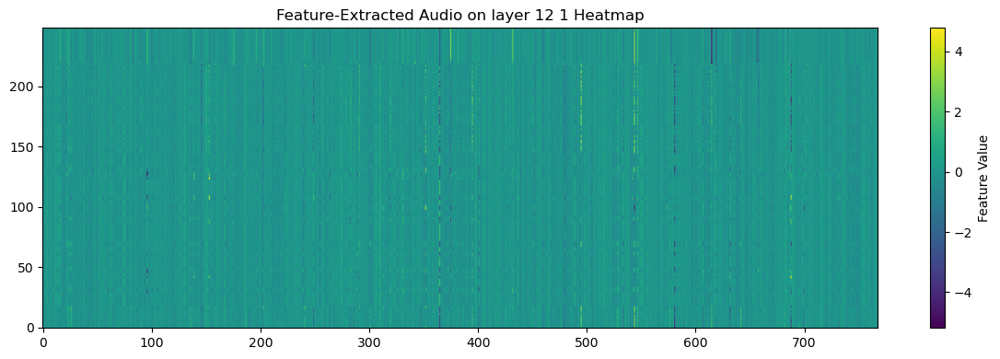

In [8]:
feature_audio = extracted_train_df[0]

plt.figure(figsize=(12, 4))
for i, f in enumerate(feature_audio):
    plt.subplot(len(feature_audio), 1, i+1)
    plt.imshow(f.numpy(), aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='Feature Value')
    plt.title(f'Feature-Extracted Audio on layer 12 {i+1} Heatmap')
plt.tight_layout()
plt.show()


In [1]:
import matplotlib.pyplot as plt
import torch

c:\Users\ASUS\anaconda3\envs\aivdenv\Lib\site-packages\torch\cuda\__init__.py:61: FutureWarning: The pynvml package is deprecated. Please install nvidia-ml-py instead. If you did not install pynvml directly, please report this to the maintainers of the package that installed pynvml for you.
  import pynvml  # type: ignore[import]


BASE LAYER 8

In [2]:
extracted_train_df = torch.load('checkpoint/FE_BASE_8L/extracted_train_df.pt')
extracted_val_df = torch.load('checkpoint/FE_BASE_8L/extracted_val_df.pt')
extracted_test_df = torch.load('checkpoint/FE_BASE_8L/extracted_test_df.pt')

print("jumlah train: ", len(extracted_train_df))
print("jumlah val: ", len(extracted_val_df))
print("jumlah test:", len(extracted_test_df))

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14176\2347907956.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_train_df = torch.load('checkpoint/FE_BASE_8L/extrac

jumlah train:  36741
jumlah val:  7357
jumlah test: 2228


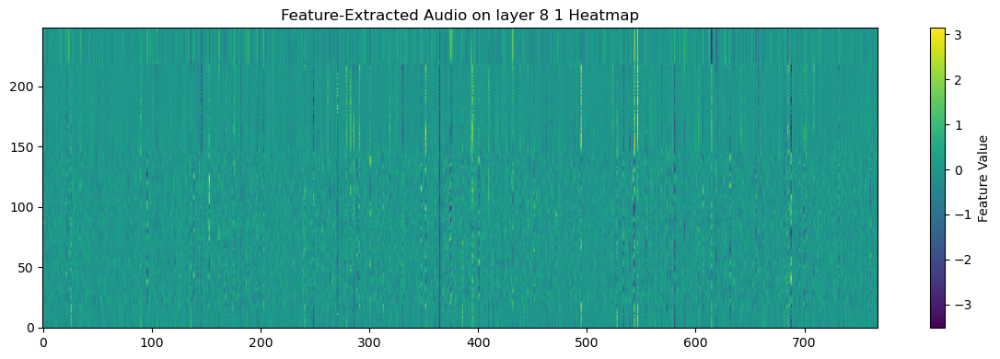

In [3]:
feature_audio = extracted_train_df[0]

plt.figure(figsize=(12, 4))
for i, f in enumerate(feature_audio):
    plt.subplot(len(feature_audio), 1, i+1)
    plt.imshow(f.numpy(), aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='Feature Value')
    plt.title(f'Feature-Extracted Audio on layer 8 {i+1} Heatmap')
plt.tight_layout()
plt.show()


BASE LAYER 4

In [3]:
import matplotlib.pyplot as plt
import torch

c:\Users\ASUS\anaconda3\envs\aivdenv\Lib\site-packages\torch\cuda\__init__.py:61: FutureWarning: The pynvml package is deprecated. Please install nvidia-ml-py instead. If you did not install pynvml directly, please report this to the maintainers of the package that installed pynvml for you.
  import pynvml  # type: ignore[import]


In [4]:
extracted_train_df = torch.load('checkpoint/FE_BASE_L4/extracted_train_df.pt')
extracted_val_df = torch.load('checkpoint/FE_BASE_L4/extracted_val_df.pt')
extracted_test_df = torch.load('checkpoint/FE_BASE_L4/extracted_test_df.pt')

print("jumlah train: ", len(extracted_train_df))
print("jumlah val: ", len(extracted_val_df))
print("jumlah test:", len(extracted_test_df))

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16732\2720384877.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extracted_train_df = torch.load('checkpoint/FE_BASE_L4/extrac

jumlah train:  36741
jumlah val:  7357
jumlah test: 2228


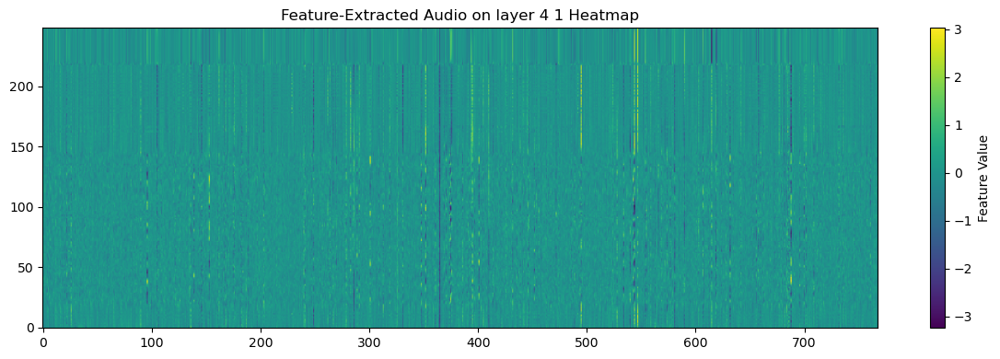

In [5]:
feature_audio = extracted_train_df[0]

plt.figure(figsize=(12, 4))
for i, f in enumerate(feature_audio):
    plt.subplot(len(feature_audio), 1, i+1)
    plt.imshow(f.numpy(), aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='Feature Value')
    plt.title(f'Feature-Extracted Audio on layer 4 {i+1} Heatmap')
plt.tight_layout()
plt.show()


SAVE FINAL PREPROCESS

In [10]:
# Extract just the tensors from (tensor, None) structure
features_list = extracted_train_df # Get just the tensor part
# Convert labels from pandas to regular list
labels_list = train_label

In [ ]:
#pooling
features_list = np.array([pool_feature(f) for f in features_list])

In [ ]:
# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/LARGE/complete_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Features: 36741, Labels: 36741
First feature shape: (1024,)
First few labels: [0, 0, 0, 0, 0]
Saved complete dataset!
----------------------------------------


In [11]:
# Extract just the tensors from (tensor, None) structure
features_list = extracted_val_df
# Convert labels from pandas to regular list
labels_list = val_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/LARGE/complete_val.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from your (tensor, None) structure
features_list = extracted_test_df
# Convert labels from pandas to regular list
labels_list = test_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/LARGE/complete_test.pt')

print("Saved complete dataset!")

Features: 7357, Labels: 7357
First feature shape: (1024,)
First few labels: [0, 1, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 2228, Labels: 2228
First feature shape: (1024,)
First few labels: [1, 0, 1, 0, 0]
Saved complete dataset!


BASE LAYER 12

In [19]:
# Extract just the tensors from (tensor, None) structure
features_list = extracted_train_df # Get just the tensor part
# Convert labels from pandas to regular list
labels_list = train_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L12/complete_train.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from (tensor, None) structure
features_list = extracted_val_df
# Convert labels from pandas to regular list
labels_list = val_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L12/complete_val.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from your (tensor, None) structure
features_list = extracted_test_df
# Convert labels from pandas to regular list
labels_list = test_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L12/complete_test.pt')

print("Saved complete dataset!")

Features: 36741, Labels: 36741
First feature shape: (768,)
First few labels: [0, 0, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 7357, Labels: 7357
First feature shape: (768,)
First few labels: [0, 1, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 2228, Labels: 2228
First feature shape: (768,)
First few labels: [1, 0, 1, 0, 0]
Saved complete dataset!


BASE LAYER 8

In [11]:
# Extract just the tensors from (tensor, None) structure
features_list = extracted_train_df # Get just the tensor part
# Convert labels from pandas to regular list
labels_list = train_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L8/complete_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Features: 36741, Labels: 36741
First feature shape: (768,)
First few labels: [0, 0, 0, 0, 0]
Saved complete dataset!
----------------------------------------


In [12]:


# Extract just the tensors from (tensor, None) structure
features_list = extracted_val_df
# Convert labels from pandas to regular list
labels_list = val_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L8/complete_val.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from your (tensor, None) structure
features_list = extracted_test_df
# Convert labels from pandas to regular list
labels_list = test_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L8/complete_test.pt')

print("Saved complete dataset!")

Features: 7357, Labels: 7357
First feature shape: (768,)
First few labels: [0, 1, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 2228, Labels: 2228
First feature shape: (768,)
First few labels: [1, 0, 1, 0, 0]
Saved complete dataset!


BASE LAYER 4

In [ ]:
# Extract just the tensors from (tensor, None) structure
features_list = extracted_train_df # Get just the tensor part
# Convert labels from pandas to regular list
labels_list = train_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L4/complete_train.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from (tensor, None) structure
features_list = extracted_val_df
# Convert labels from pandas to regular list
labels_list = val_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L4/complete_val.pt')

print("Saved complete dataset!")
print("-" * 40)

# Extract just the tensors from your (tensor, None) structure
features_list = extracted_test_df
# Convert labels from pandas to regular list
labels_list = test_label

#pooling
features_list = np.array([pool_feature(f) for f in features_list])

# Verify they match
print(f"Features: {len(features_list)}, Labels: {len(labels_list)}")
print(f"First feature shape: {features_list[0].shape}")
print(f"First few labels: {labels_list[:5]}")

# Save everything in one .pt file
torch.save({
    'features': features_list,
    'labels': labels_list,
    'metadata': {
        'num_samples': len(features_list),
        'feature_shape': features_list[0].shape,
        'label_type': type(labels_list[0])
    }
}, 'clean_se_clean_cleannya/BASE_L4/complete_test.pt')

print("Saved complete dataset!")

Features: 36741, Labels: 36741
First feature shape: (768,)
First few labels: [0, 0, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 7357, Labels: 7357
First feature shape: (768,)
First few labels: [0, 1, 0, 0, 0]
Saved complete dataset!
----------------------------------------
Features: 2228, Labels: 2228
First feature shape: (768,)
First few labels: [1, 0, 1, 0, 0]
Saved complete dataset!


CHECKPOINT OVERSAMPLING HERE

In [23]:
import torch

In [12]:
train = torch.load('clean_se_clean_cleannya/BASE_L12/complete_train.pt')
val = torch.load('clean_se_clean_cleannya/BASE_L12/complete_val.pt')
test = torch.load('clean_se_clean_cleannya/BASE_L12/complete_test.pt')

C:\Users\ASUS\AppData\Local\Temp\ipykernel_23308\3384840146.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  train = torch.load('clean_se_clean_cleannya/BASE_L12/complete

In [9]:
print(f"Loaded {len(train['features'])} samples")
print(f"First feature: {train['features'][0].shape}")
print(f"First label: {train['labels'][0]}")

print(f"Loaded {len(val['features'])} samples")
print(f"First feature: {val['features'][0].shape}")
print(f"First label: {val['labels'][0]}")

print(f"Loaded {len(test['features'])} samples")
print(f"First feature: {test['features'][0].shape}")
print(f"First label: {test['labels'][0]}")


Loaded 36741 samples
First feature: (768,)
First label: 0
Loaded 7357 samples
First feature: (768,)
First label: 0
Loaded 2228 samples
First feature: (768,)
First label: 1


In [19]:
train = torch.load('clean_se_clean_cleannya/BASE_L8/complete_train.pt')
val = torch.load('clean_se_clean_cleannya/BASE_L8/complete_val.pt')
test = torch.load('clean_se_clean_cleannya/BASE_L8/complete_test.pt')

print(f"Loaded {len(train['features'])} samples")
print(f"First feature: {train['features'][0].shape}")
print(f"First label: {train['labels'][0]}")

print(f"Loaded {len(val['features'])} samples")
print(f"First feature: {val['features'][0].shape}")
print(f"First label: {val['labels'][0]}")

print(f"Loaded {len(test['features'])} samples")
print(f"First feature: {test['features'][0].shape}")
print(f"First label: {test['labels'][0]}")


C:\Users\ASUS\AppData\Local\Temp\ipykernel_23308\3798372711.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  train = torch.load('clean_se_clean_cleannya/BASE_L8/complete_

Loaded 36741 samples
First feature: (768,)
First label: 0
Loaded 7357 samples
First feature: (768,)
First label: 0
Loaded 2228 samples
First feature: (768,)
First label: 1


C:\Users\ASUS\AppData\Local\Temp\ipykernel_23308\3798372711.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  val = torch.load('clean_se_clean_cleannya/BASE_L8/complete_va

In [21]:
train = torch.load('clean_se_clean_cleannya/BASE_L4/complete_train.pt')
val = torch.load('clean_se_clean_cleannya/BASE_L4/complete_val.pt')
test = torch.load('clean_se_clean_cleannya/BASE_L4/complete_test.pt')

print(f"Loaded {len(train['features'])} samples")
print(f"First feature: {train['features'][0].shape}")
print(f"First label: {train['labels'][0]}")

print(f"Loaded {len(val['features'])} samples")
print(f"First feature: {val['features'][0].shape}")
print(f"First label: {val['labels'][0]}")

print(f"Loaded {len(test['features'])} samples")
print(f"First feature: {test['features'][0].shape}")
print(f"First label: {test['labels'][0]}")


C:\Users\ASUS\AppData\Local\Temp\ipykernel_23308\290409735.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  train = torch.load('clean_se_clean_cleannya/BASE_L4/complete_t

Loaded 36741 samples
First feature: (768,)
First label: 0
Loaded 7357 samples
First feature: (768,)
First label: 0
Loaded 2228 samples
First feature: (768,)
First label: 1


C:\Users\ASUS\AppData\Local\Temp\ipykernel_23308\290409735.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  val = torch.load('clean_se_clean_cleannya/BASE_L4/complete_val

smote oversampling

ini mestinya abis feature extraction karena smote only works on features

In [15]:

#oversampling with smote
from imblearn.over_sampling import SMOTE
import numpy as np

In [16]:
def smote_resampler(dataset):
    print("Before SMOTE")

    #smote resample input = (X, y)
    X = dataset['features']
    y = dataset['labels']
    unique, counts = np.unique(y, return_counts=True)
    for label, count in zip(unique, counts):
        print(f"Class {label}: {count}")

    sm = SMOTE(random_state=42)

    # sample with dataset (feature and label set) so (X, y)
    balanced_X, balanced_y = sm.fit_resample(X, y)

    #show new distribution
    unique, counts = np.unique(balanced_y, return_counts=True)

    print("After SMOTE Oversampling:")
    for label, count in zip(unique, counts):
        print(f"Class {label}: {count}")
    print(f"Total Samples After Resampling: {len(balanced_y)}")
    print("-" * 40)

    return balanced_X, balanced_y


LARGE OVERSAMPLING

In [12]:
balanced_X_train, balanced_y_train = smote_resampler(train)
# Save everything in one .pt file
torch.save({
    'features': balanced_X_train,
    'labels': balanced_y_train,
    'metadata': {
        'num_samples': len(balanced_X_train),
        'feature_shape': balanced_X_train[0].shape,
        'label_type': type(balanced_y_train[0])
    }
}, 'clean_se_clean_cleannya/LARGE/complete_smote_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Before SMOTE
Class 0: 29757
Class 1: 6984
After SMOTE Oversampling:
Class 0: 29757
Class 1: 29757
Total Samples After Resampling: 59514
----------------------------------------
Saved complete dataset!
----------------------------------------


L12 OVERSAMPLING

In [17]:
balanced_X_train, balanced_y_train = smote_resampler(train)
# Save everything in one .pt file
torch.save({
    'features': balanced_X_train,
    'labels': balanced_y_train,
    'metadata': {
        'num_samples': len(balanced_X_train),
        'feature_shape': balanced_X_train[0].shape,
        'label_type': type(balanced_y_train[0])
    }
}, 'clean_se_clean_cleannya/BASE_L12/complete_smote_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Before SMOTE
Class 0: 29757
Class 1: 6984
After SMOTE Oversampling:
Class 0: 29757
Class 1: 29757
Total Samples After Resampling: 59514
----------------------------------------
Saved complete dataset!
----------------------------------------


L8 OVERSAMPLING

In [20]:
balanced_X_train, balanced_y_train = smote_resampler(train)
# Save everything in one .pt file
torch.save({
    'features': balanced_X_train,
    'labels': balanced_y_train,
    'metadata': {
        'num_samples': len(balanced_X_train),
        'feature_shape': balanced_X_train[0].shape,
        'label_type': type(balanced_y_train[0])
    }
}, 'clean_se_clean_cleannya/BASE_L8/complete_smote_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Before SMOTE
Class 0: 29757
Class 1: 6984
After SMOTE Oversampling:
Class 0: 29757
Class 1: 29757
Total Samples After Resampling: 59514
----------------------------------------
Saved complete dataset!
----------------------------------------


L4 OVERSAMPLING

In [22]:
balanced_X_train, balanced_y_train = smote_resampler(train)
# Save everything in one .pt file
torch.save({
    'features': balanced_X_train,
    'labels': balanced_y_train,
    'metadata': {
        'num_samples': len(balanced_X_train),
        'feature_shape': balanced_X_train[0].shape,
        'label_type': type(balanced_y_train[0])
    }
}, 'clean_se_clean_cleannya/BASE_L4/complete_smote_train.pt')

print("Saved complete dataset!")
print("-" * 40)

Before SMOTE
Class 0: 29757
Class 1: 6984
After SMOTE Oversampling:
Class 0: 29757
Class 1: 29757
Total Samples After Resampling: 59514
----------------------------------------
Saved complete dataset!
----------------------------------------


note: only training set needs oversampling if imbalanced. validation and test must stay as it is. and therefore left alone if imbalanced

CODE GRAVEYARD

In [ ]:
#concat train
extracted_labelled_train_df =  pd.concat([extracted_train_df.loc[:, 0], val_label], axis=1)
extracted_labelled_train_df = extracted_labelled_train_df.rename(columns={0: 'features'})
print(extracted_labelled_train_df[:5])

#dropping train
print("sample after drop: ", len(extracted_labelled_train_df))
extracted_labelled_train_df = extracted_labelled_train_df.dropna()
print(len("sample after drop: ", extracted_labelled_train_df))

#concat val
extracted_labelled_val_df = pd.concat([extracted_val_df.loc[:, 0], val_label], axis=1)
extracted_labelled_val_df = extracted_labelled_val_df.rename(columns={0: 'features'})
extracted_labelled_val_df[:5]

#dropping val
print("sample after drop: ", len(extracted_labelled_val_df))
extracted_labelled_val_df = extracted_labelled_val_df.dropna()
print("sample after drop: ", len(extracted_labelled_val_df))

#concat test
extracted_labelled_test_df = pd.concat([extracted_test_df.loc[:, 0], test_label], axis=1)
extracted_labelled_test_df = extracted_labelled_test_df.rename(columns={0: 'features'})
extracted_labelled_test_df[:5]

#dropping test
print("sample after drop: ", len(extracted_labelled_test_df))
extracted_labelled_test_df = extracted_labelled_test_df.dropna()
print("sample after drop: ", len(extracted_labelled_test_df))

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

class SimpleMLP(nn.Module):
    def __init__(self, input_size, hidden_sizes, output_size):
        super(SimpleMLP, self).__init__()
        layers = []
        prev_size = input_size

        for hidden_size in hidden_sizes:
            layers.append(nn.Linear(prev_size, hidden_size))
            layers.append(nn.ReLU())
            prev_size = hidden_size

        layers.append(nn.Linear(prev_size, output_size))
        self.network = nn.Sequential(*layers)

    def forward(self, x):
        return self.network(x)

def prepare_feature_data(df):
    """Convert dataframe with feature columns and label column into numpy arrays."""
    print("Preparing features (input is already numeric)...")
    
    # All columns except 'label' are features
    feature_cols = [c for c in df.columns if c != 'label']
    
    X = df[feature_cols].values.astype(np.float32)
    y = df['label'].values.astype(np.float32)
    
    print(f"  → Features shape: {X.shape}")
    print(f"  → Labels shape:   {y.shape}")
    return X, y

def train_mlp(train_df, val_df, hidden_sizes=[256, 128], epochs=500):
    print("=" * 50)
    print("STARTING MLP TRAINING (FEATURE INPUT)")
    print("=" * 50)

    # Step 1: Prepare data
    X_train, y_train = prepare_feature_data(train_df)
    X_val, y_val = prepare_feature_data(val_df)

    # Convert to tensors
    X_train = torch.FloatTensor(X_train)
    y_train = torch.FloatTensor(y_train).reshape(-1, 1)
    X_val = torch.FloatTensor(X_val)
    y_val = torch.FloatTensor(y_val).reshape(-1, 1)

    print(f"Training data: {X_train.shape}")
    print(f"Validation data: {X_val.shape}")

    # Step 2: Model
    input_size = X_train.shape[1]
    model = SimpleMLP(input_size, hidden_sizes, 1)
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    print(f"Model: Input({input_size}) -> {hidden_sizes} -> Output(1)")

    # Step 3: Training
    best_val_loss = float('inf')
    patience = 15
    patience_counter = 0

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()
        outputs = model(X_train)
        loss = criterion(outputs, y_train)
        loss.backward()
        optimizer.step()

        if (epoch + 1) % 5 == 0:
            model.eval()
            with torch.no_grad():
                val_outputs = model(X_val)
                val_loss = criterion(val_outputs, y_val)
                predictions = (torch.sigmoid(val_outputs) > 0.5).float()
                val_acc = (predictions == y_val).float().mean()

            print(f'Epoch {epoch+1}/{epochs}, '
                  f'Loss: {loss.item():.4f}, '
                  f'Val Loss: {val_loss.item():.4f}, '
                  f'Val Acc: {val_acc.item():.4f}')

            if val_loss < best_val_loss:
                best_val_loss = val_loss
                patience_counter = 0
                print("  ↳ New best!")
            else:
                patience_counter += 1
                if patience_counter >= patience:
                    print(f"  ↳ Early stopping (no improvement for {patience} evals)")
                    break

        if (epoch + 1) % 50 == 0:
            print(f"--- Progress: {epoch+1}/{epochs} epochs ---")

    print("TRAINING COMPLETED")
    return model, X_train, X_val, y_train, y_val




In [ ]:
#loading from csv

#df_train = pd.read_csv('clean_se_clean_cleannya/extracted_labelled_train_df.csv')
#df_val = pd.read_csv('clean_se_clean_cleannya/extracted_labelled_validation_df.csv')


In [ ]:
df_train

,features,label
0,"tensor([[[ 0.1348, 0.1510, 0.3621, ..., 0....",0
1,"tensor([[[ 0.0738, 0.2961, 0.2621, ..., -0....",0
2,"tensor([[[ 1.2212e-01, 1.4507e-01, -5.6912e-0...",1
3,"tensor([[[ 0.1492, 0.2328, 0.1992, ..., 0....",0
4,"tensor([[[ 0.1851, 0.2929, 0.2585, ..., 0....",1
...,...,...
61434,"tensor([[[ 0.1198, 0.1911, 0.1828, ..., 0....",1
61435,"tensor([[[ 0.2221, 0.2723, 0.2012, ..., 0....",1
61436,"tensor([[[ 0.1351, 0.2006, 0.0665, ..., -0....",0
61437,"tensor([[[ 0.1627, 0.0451, 0.2575, ..., -0....",0


In [ ]:
if __name__ == "__main__":
    # Example usage:
    # df_train, df_val = ... (your preprocessed feature DataFrames)
    model, X_train, X_val, y_train, y_val = train_mlp(
        df_train,
        df_val
    )

    print("Final evaluation...")
    model.eval()
    with torch.no_grad():
        train_pred = torch.sigmoid(model(X_train))
        val_pred = torch.sigmoid(model(X_val))

        train_acc = ((train_pred > 0.5).float() == y_train).float().mean()
        val_acc = ((val_pred > 0.5).float() == y_val).float().mean()

        print(f"Final Train Accuracy: {train_acc.item():.4f}")
        print(f"Final Val Accuracy: {val_acc.item():.4f}")

In [ ]:
df_train = shuffled_train_df
df_val = shuffled_val_df

In [ ]:

import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from sklearn.model_selection import train_test_split

class SimpleMLP(nn.Module):
    def __init__(self, input_size, hidden_sizes, output_size):
        super(SimpleMLP, self).__init__()
        layers = []
        prev_size = input_size
        
        for hidden_size in hidden_sizes:
            layers.append(nn.Linear(prev_size, hidden_size))
            layers.append(nn.ReLU())
            prev_size = hidden_size
        
        layers.append(nn.Linear(prev_size, output_size))
        self.network = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.network(x)

def process_sequence(sequence, max_features=1000):
    """Extract key features from sequence to avoid memory issues"""
    print(f"  Processing sequence type: {type(sequence)}")
    
    if isinstance(sequence, torch.Tensor):
        print(f"  Tensor shape: {sequence.shape}")
        flattened = sequence.flatten().numpy()
        
        # Take only the most important features to save memory
        if len(flattened) > max_features:
            # Option 1: Take first N features
            result = flattened[:max_features]
            print(f"  Reduced from {len(flattened)} to {len(result)} features")
        else:
            result = flattened
            print(f"  Using {len(result)} features")
        return result
        
    elif isinstance(sequence, list):
        print(f"  List length: {len(sequence)}")
        if sequence and isinstance(sequence[0], torch.Tensor):
            # Take mean of each feature dimension instead of flattening everything
            tensors = [t for t in sequence if isinstance(t, torch.Tensor)]
            if tensors:
                # Stack and take mean across time steps
                stacked = torch.stack(tensors)
                result = stacked.mean(dim=0).flatten().numpy()  # Mean pooling
                
                if len(result) > max_features:
                    result = result[:max_features]
                print(f"  Mean pooled to {len(result)} features")
                return result
        
        # Fallback: take first element or small sample
        sample = sequence[:10]  # Take first 10 elements
        result = np.array(sample).flatten()[:max_features]
        print(f"  Sampled to {len(result)} features")
        return result
        
    else:
        result = np.array(sequence).flatten()[:max_features]
        print(f"  Other type sampled to {len(result)} features")
        return result

def prepare_features(df, max_features=1000):
    """Convert dataframe to features with memory optimization"""
    print("Starting feature preparation...")
    features = []
    labels = []
    
    sample_count = min(5, len(df))  # Check first 5 samples
    print(f"Checking first {sample_count} samples to determine feature size...")
    
    # First pass: determine optimal feature size
    feature_sizes = []
    for idx in range(sample_count):
        try:
            sample_feat = process_sequence(df.iloc[idx]['sequence'], max_features)
            feature_sizes.append(len(sample_feat))
            print(f"  Sample {idx}: {len(sample_feat)} features")
        except Exception as e:
            print(f"  Error in sample {idx}: {e}")
    
    if feature_sizes:
        optimal_size = min(max(feature_sizes), max_features)
        print(f"Using feature size: {optimal_size}")
    else:
        optimal_size = max_features
        print(f"Using default feature size: {optimal_size}")
    
    # Second pass: process all data with fixed size
    print("Processing all data...")
    for idx, row in df.iterrows():
        if idx % 100 == 0:
            print(f"  Processed {idx}/{len(df)} rows...")
            
        try:
            feature_vector = process_sequence(row['sequence'], optimal_size)
            
            # Ensure consistent size
            if len(feature_vector) < optimal_size:
                # Pad if too small
                feature_vector = np.pad(feature_vector, (0, optimal_size - len(feature_vector)))
            elif len(feature_vector) > optimal_size:
                # Truncate if too large
                feature_vector = feature_vector[:optimal_size]
                
            features.append(feature_vector)
            labels.append(row['label'])
            
        except Exception as e:
            print(f"  ERROR processing row {idx}: {e}")
            continue
    
    print(f"Successfully processed {len(features)} rows")
    print(f"Final feature matrix: {len(features)} x {optimal_size}")
    
    return np.array(features, dtype=np.float32), np.array(labels, dtype=np.float32)

def train_mlp(train_df, val_df, hidden_sizes=[256, 128], epochs=500, max_features=1000):
    print("=" * 50)
    print("STARTING MLP TRAINING (USING SEPARATE VALIDATION SET)")
    print("=" * 50)
    
    # Step 1: Prepare training features
    print("Step 1: Preparing training features...")
    X_train, y_train = prepare_features(train_df, max_features)
    
    # Step 2: Prepare validation features
    print("Step 2: Preparing validation features...")
    X_val, y_val = prepare_features(val_df, max_features)
    
    print(f"Training feature matrix shape: {X_train.shape}")
    print(f"Validation feature matrix shape: {X_val.shape}")
    
    # Convert to tensors
    X_train = torch.FloatTensor(X_train)
    y_train = torch.FloatTensor(y_train).reshape(-1, 1)
    X_val = torch.FloatTensor(X_val)
    y_val = torch.FloatTensor(y_val).reshape(-1, 1)
    
    print(f"Training data: {X_train.shape}")
    print(f"Validation data: {X_val.shape}")
    
    # Step 3: Create model
    input_size = int(X_train.shape[1])  # <-- ensure it's a pure Python int
    print(f"Step 3: Creating model with input size: {input_size}")
    model = SimpleMLP(input_size, hidden_sizes, 1)
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    
    print(f"Model: Input({input_size}) -> {hidden_sizes} -> Output(1)")
    
    # Step 4: Training loop
    print("Step 4: Starting training...")
    best_val_loss = float('inf')
    patience = 15
    patience_counter = 0
    
    for epoch in range(epochs):
        # Train
        model.train()
        optimizer.zero_grad()
        outputs = model(X_train)
        loss = criterion(outputs, y_train)
        loss.backward()
        optimizer.step()
        
        # Validate every 5 epochs
        if (epoch + 1) % 5 == 0:
            model.eval()
            with torch.no_grad():
                val_outputs = model(X_val)
                val_loss = criterion(val_outputs, y_val)
                predictions = (torch.sigmoid(val_outputs) > 0.5).float()
                val_acc = (predictions == y_val).float().mean()
            
            print(f'Epoch {epoch+1}/{epochs}, Loss: {loss.item():.4f}, Val Loss: {val_loss.item():.4f}, Val Acc: {val_acc.item():.4f}')
            
            # Early stopping
            if val_loss < best_val_loss:
                best_val_loss = val_loss
                patience_counter = 0
                print(f"  ↳ New best!")
            else:
                patience_counter += 1
                if patience_counter >= patience:
                    print(f"  ↳ Early stopping after {patience} epochs no improvement")
                    break
        
        # Progress indicator
        if (epoch + 1) % 50 == 0:
            print(f"--- Progress: {epoch+1}/{epochs} epochs ---")
    
    print("TRAINING COMPLETED")
    return model, X_train, X_val, y_train, y_val


In [ ]:
if __name__ == "__main__":
    print("Initializing MLP training with memory optimization...")
    model, X_train, X_val, y_train, y_val = train_mlp(
        df_train,
        df_val,
        max_features=500
    )
    
    print("Final evaluation...")
    model.eval()
    with torch.no_grad():
        train_pred = torch.sigmoid(model(X_train))
        val_pred = torch.sigmoid(model(X_val))
        
        train_acc = ((train_pred > 0.5).float() == y_train).float().mean()
        val_acc = ((val_pred > 0.5).float() == y_val).float().mean()
        
        print(f"Final Train Accuracy: {train_acc.item():.4f}")
        print(f"Final Val Accuracy: {val_acc.item():.4f}")


Initializing MLP training with memory optimization...
STARTING MLP TRAINING (USING SEPARATE VALIDATION SET)
Step 1: Preparing training features...
Starting feature preparation...
Checking first 5 samples to determine feature size...
  Processing sequence type: <class 'torch.Tensor'>
  Tensor shape: torch.Size([1, 96000])
  Reduced from 96000 to 500 features
  Sample 0: 500 features
  Processing sequence type: <class 'torch.Tensor'>
  Tensor shape: torch.Size([1, 96000])
  Reduced from 96000 to 500 features
  Sample 1: 500 features
  Processing sequence type: <class 'torch.Tensor'>
  Tensor shape: torch.Size([1, 96000])
  Reduced from 96000 to 500 features
  Sample 2: 500 features
  Processing sequence type: <class 'torch.Tensor'>
  Tensor shape: torch.Size([1, 96000])
  Reduced from 96000 to 500 features
  Sample 3: 500 features
  Processing sequence type: <class 'torch.Tensor'>
  Tensor shape: torch.Size([1, 96000])
  Reduced from 96000 to 500 features
  Sample 4: 500 features
Using f

In [ ]:
print(model)

SimpleMLP(
  (network): Sequential(
    (0): Linear(in_features=500, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=128, bias=True)
    (3): ReLU()
    (4): Linear(in_features=128, out_features=1, bias=True)
  )
)


In [ ]:
#example of each cut

waveform, sample_rate = torchaudio.load(df_training_real_outliers.loc[i, 'file path'])

#cutting down duration to treshold = 6
treshold_high = 5
treshold_low = 2
max_samples = int(sample_rate * treshold_high)
min_samples = int(sample_rate * treshold_low)


start = 0 * max_samples
end = start + max_samples
chunk = waveform[:, start:end]

print(chunk.size())
print(chunk)
print("-" * 40)

start = 1 * max_samples
end = start + max_samples
chunk = waveform[:, start:end]

print(chunk.size())
print(chunk)
print("-" * 40)

'''
In Python, slicing like my_list[10:20] 
or array[:, 10:20] automatically stops 
at the array’s maximum length.

so we can also make from an index to "the end" and vice versa
example:

'''

l1 = [0, 1, 2, 3, 4, 5, 6, 7 ]
slice = l1[2:] #or [2::]

print(slice)
print("-" * 40)

slice = l1[:6]
print(slice)

torch.Size([1, 96000])
tensor([[0.0443, 0.0515, 0.0456,  ..., 0.0653, 0.0664, 0.0683]])
----------------------------------------
torch.Size([1, 3802])
tensor([[0.0677, 0.0635, 0.0612,  ..., 0.0659, 0.0613, 0.0639]])
----------------------------------------
[2, 3, 4, 5, 6, 7]
----------------------------------------
[0, 1, 2, 3, 4, 5]


In [ ]:
'''
Note:
torchaudio.load() returns waveform (torch.Tensor) and sample rate (int)
torch is the library, Tensor is the class. Think of a class as a custom made data structure
'''
print(type(waveform))
print(type(sample_rate))
print(type(1)) #--> in python, datatype is just a class


<class 'torch.Tensor'>
<class 'int'>
<class 'int'>


EXAMPLE

In [ ]:
bundle = torchaudio.pipelines.WAV2VEC2_BASE
model = bundle.get_model()
# Access the feature extractor
#feature_extractor = bundle.get_feature_extractor()

#get other information like the sample rate
model_expected_sample_rate = bundle.sample_rate

print("model expected sample:", model_expected_sample_rate)

label = ["fake", "fake", "real"]

dataset_sample = []

path_samples = os.path.join(cwd, "dataset", "for-norm", "testing", "sample_temp")

for i, samples in enumerate(os.listdir(path_samples), start = 1):
    sample_path = os.path.join(path_samples, samples)
    waveform_path = sample_path
    waveform, sample_rate = torchaudio.load(waveform_path) 

    if sample_rate != model_expected_sample_rate:
        print(f"sample rate incompatible: {samples} {sample_rate} ")
        print("perform resampling...")
        resampler = torchaudio.transforms.Resample(sample_rate, model_expected_sample_rate)
        waveform = resampler(waveform)
        #this is an object
    else:
        print(f"sample rate confirmed {sample_rate}")

    dataset_sample.append((waveform, label[i-1]))

for j, f in enumerate(dataset_sample, start = 1): #loop for displayiing samples
    # j is index, f is files    
        print(f"  {j}. {dataset_sample[j-1]}")



model expected sample: 16000
sample rate confirmed 16000
sample rate confirmed 16000
sample rate confirmed 16000
  1. (tensor([[0.0880, 0.0883, 0.0874,  ..., 0.0862, 0.0823, 0.0811]]), 'fake')
  2. (tensor([[-0.0233, -0.0265, -0.0292,  ...,  0.0592,  0.0594,  0.0591]]), 'fake')
  3. (tensor([[-0.0832, -0.0941, -0.0933,  ..., -0.1112, -0.0284,  0.0975]]), 'real')


In [ ]:
#feature extraction
features = []
for i, j in enumerate(dataset_sample):
    features.append(model(dataset_sample[i][0]))

print(features[1])

#for j, f in enumerate(features, start = 1): #loop for displayiing samples
    # j is index, f is files    
#        print(f"  {j}. {features[1]}")

print(features[1][0].size())


(tensor([[[ 0.2114,  0.3066,  0.2028,  ...,  0.2101,  0.0135, -0.1094],
         [-0.2310,  0.1651,  0.1532,  ...,  0.0186,  0.5158, -0.3781],
         [-0.2356,  0.1390,  0.1390,  ..., -0.0064,  0.5367, -0.4047],
         ...,
         [-0.2526,  0.1278,  0.1158,  ...,  0.0276,  0.5992, -0.3889],
         [-0.2313,  0.1384,  0.1376,  ...,  0.0304,  0.5648, -0.3290],
         [ 0.2007,  0.1632,  0.1022,  ..., -0.0172,  0.1892, -0.1682]]],
       grad_fn=<NativeLayerNormBackward0>), None)
torch.Size([1, 121, 768])


<p>

1. first is tensor (feature as tensor) and grad_fn=<NativeLayerNormBackward0> which is NOT part of your data - just PyTorch's internal bookkeeping.

2. Second return value (usually attention masks, but None here) 


Size: channel, sequence_length, feature dimension
torch.Size([1, 121, 768])

note:
Your shape change: [1, 96000] → [1, 121, 768]
-NOT different data types - both are float32 tensors
-Just different DIMENSIONS of the same tensor type
-wav2vec transforms raw audio → semantic features

semantic features:
think of...
[phoneme_info, speaker_gender, vocal_tone, emotion, ...]
"What the audio MEANS" - interpreted meaning
wav2vec2-base has 768 dimensions but we dont know what each dimension 
actually represent, The exact "meaning" of each feature, Which dimensions matter for AI detection.

"wav2vec learned these features automatically during training
Even the creators don't know exactly what each dimension does!"

</p>                                                                                                                                                    

In [ ]:
import torchaudio
import torchaudio.pipelines
from transformers import Wav2Vec2Model
import os
import torch
import torch.nn as nn

# Add MLP classifier
class VoiceClassifier(nn.Module):
    def __init__(self, input_dim=768, hidden_dim=256, num_classes=2):
        super().__init__()
        self.mlp = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, num_classes)
        )
    
    def forward(self, x):
        return self.mlp(x)

# Your existing code
bundle = torchaudio.pipelines.WAV2VEC2_BASE
model = bundle.get_model()
model_expected_sample_rate = bundle.sample_rate

print("model expected sample:", model_expected_sample_rate)

label = ["fake", "fake", "real"]
dataset_sample = []
path_samples = os.path.join(cwd, "dataset", "for-norm", "testing", "sample_temp")

for i, samples in enumerate(os.listdir(path_samples), start=1):
    sample_path = os.path.join(path_samples, samples)
    waveform, sample_rate = torchaudio.load(sample_path) 

    if sample_rate != model_expected_sample_rate:
        print(f"sample rate incompatible: {samples} {sample_rate} ")
        print("perform resampling...")
        resampler = torchaudio.transforms.Resample(sample_rate, model_expected_sample_rate)
        waveform = resampler(waveform)
    
    dataset_sample.append((waveform, label[i-1]))

# Initialize MLP
mlp_classifier = VoiceClassifier()

# Extract features and classify
for j, (waveform, true_label) in enumerate(dataset_sample):
    print(f"Processing sample {j+1}: {true_label}")
    
    # Extract features with wav2vec
    with torch.no_grad():
        features, _ = model(waveform)  # features shape: [1, seq_len, 768]
    
    # Aggregate features (mean pooling)
    aggregated = features.mean(dim=1)  # [1, 768]
    
    # Get classification
    logits = mlp_classifier(aggregated)  # [1, 2]
    probabilities = torch.softmax(logits, dim=-1)
    prediction = torch.argmax(logits, dim=-1)
    
    predicted_label = "real" if prediction.item() == 1 else "fake"
    
    print(f"  True: {true_label}, Predicted: {predicted_label}")
    print(f"  Probabilities: Fake {probabilities[0][0]:.3f}, Real {probabilities[0][1]:.3f}")
    print("-" * 40)


    

c:\Users\ASUS\anaconda3\envs\aivdenv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


model expected sample: 16000
Processing sample 1: fake
  True: fake, Predicted: fake
  Probabilities: Fake 0.520, Real 0.480
----------------------------------------
Processing sample 2: fake
  True: fake, Predicted: fake
  Probabilities: Fake 0.518, Real 0.482
----------------------------------------
Processing sample 3: real
  True: real, Predicted: fake
  Probabilities: Fake 0.514, Real 0.486
----------------------------------------


In [ ]:
waveform_path = os.path.join(file_paths, f)
waveform, sample_rate = torchaudio.load(waveform_path) 
print(waveform.shape)

TypeError: join() argument must be str, bytes, or os.PathLike object, not 'tuple'

In [ ]:
print(error_files)

NOTE DUMP

In [ ]:
#code dump
'''
with open("datasets/error_file_list.csv", "w", newline="") as error:
    writer_e.writerow(["dataset", "filename", "file path", "reason"])
    writer_e.writerows(error_files)
'''
    
#insert outliers for this dataset to csv
'''
with open("datasets/outliers_list.csv", "w", newline="") as f:
    writer_o = csv.writer(f)
    #csv.writer(f) is a function that that creates and gives an object
    #with the class type Writer. this object type is stateful-->remembers a state of file (f)
    # writer is the variable POINTING to said object
    #the object EXIST IN MEMORY
    #YOU CAN'T PHYSICALLY SEE THE OBJECT IN YOUR CODE, JUST ACCEPT IT.
    #but people will refer to writer as the object (even though it's not)
    writer_o.writerow(["dataset", "filename", "duration", "file path"])
    writer_o.writerows(outliers)
'''

'''
outliers.append((name, f, duration, waveform_path))
#list append accept 1 argument so for 4d list
#put them in tuple ((, , , ,))

error_files.append((name, f, waveform_path, e))
'''

